In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.notebook import tqdm
import cv2
from PIL import Image
import re
from pathlib import Path
from sklearn.model_selection import GroupKFold
import warnings
warnings.filterwarnings("ignore")

In [2]:
DATA_DIR = '/kaggle/input/uw-madison-gi-tract-image-segmentation'
TRAIN_DIR = os.path.join(DATA_DIR, 'train')
TRAIN_CSV = os.path.join(DATA_DIR, 'train.csv')

In [3]:
def load_data():
    """Load training data and perform initial exploration"""
    df = pd.read_csv(TRAIN_CSV)
    print(f"Training data shape: {df.shape}")
    
    # Display first few rows of the dataset
    print("\nFirst few rows of the training data:")
    display(df.head())
    
    # Check for missing values
    print("\nMissing values in the dataset:")
    display(df.isnull().sum())
    
    return df

In [4]:
def explore_dataset_structure(df):
    """Explore the structure of the dataset"""
    print("Dataset columns:", df.columns.tolist())
    
    # Extract case, day, and slice from the id column
    # Format: case{case}_day{day}_slice_{slice}
    if 'id' in df.columns:
        df[['case', 'day', 'slice']] = df['id'].str.extract(r'case(\d+)_day(\d+)_slice_(\d+)')
        df['case'] = df['case'].astype(int)
        df['day'] = df['day'].astype(int)
        df['slice'] = df['slice'].astype(int)
    
    # Extract unique cases, days, and slices
    cases = df['case'].unique()
    days = df['day'].unique()
    
    print(f"\nNumber of unique cases: {len(cases)}")
    print(f"Number of unique days: {len(days)}")
    
    # Create a case-day count
    case_day_df = df[['case', 'day']].drop_duplicates()
    case_counts = case_day_df['case'].value_counts()
    
    print("\nDistribution of days per case:")
    display(case_counts.describe())
    
    # Plot distribution of days per case
    plt.figure(figsize=(12, 6))
    sns.histplot(case_counts, kde=True)
    plt.title('Distribution of Days per Case')
    plt.xlabel('Number of Days')
    plt.ylabel('Frequency')
    plt.grid(True, alpha=0.3)
    plt.show()
    
    # Explore class distribution
    class_counts = df['class'].value_counts()
    print("\nClass distribution:")
    display(class_counts)
    
    # Visualize class distribution
    plt.figure(figsize=(10, 6))
    sns.barplot(x=class_counts.index, y=class_counts.values)
    plt.title('Distribution of Classes')
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    plt.show()
    
    return cases, days


In [5]:
def decode_rle(rle, shape=(266, 266)):
    """Decode RLE to mask"""
    if pd.isna(rle):
        return np.zeros(shape)
    
    # Check if the string is empty
    if not rle or rle.strip() == '':
        return np.zeros(shape)
    
    try:
        s = rle.split()
        starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
        starts -= 1
        ends = starts + lengths
        img = np.zeros(shape[0] * shape[1], dtype=np.uint8)
        
        for lo, hi in zip(starts, ends):
            img[lo:hi] = 1
        
        return img.reshape(shape)
    except Exception as e:
        print(f"Error decoding RLE: {str(e)}, RLE: {rle}")
        return np.zeros(shape)

In [6]:
def extract_metadata_from_filepath(file_path):
    """Extract metadata from image filepath"""
    # Example path: .../case101/case101_day20/scans/slice_0001_266_266_1.50_1.50.png
    parts = file_path.split('/')
    
    case_folder = parts[-4]  # case101
    day_folder = parts[-3]   # case101_day20
    slice_file = parts[-1]   # slice_0001_266_266_1.50_1.50.png
    
    # Extract case number
    case_match = re.search(r'case(\d+)', case_folder)
    case_id = int(case_match.group(1)) if case_match else None
    
    # Extract day number
    day_match = re.search(r'day(\d+)', day_folder)
    day = int(day_match.group(1)) if day_match else None
    
    # Extract slice number
    slice_match = re.search(r'slice_(\d+)', slice_file)
    slice_id = int(slice_match.group(1)) if slice_match else None
    
    # Extract dimensions and pixel spacing
    dimensions_match = re.search(r'(\d+)_(\d+)_(\d+\.\d+)_(\d+\.\d+)', slice_file)
    if dimensions_match:
        width = int(dimensions_match.group(1))
        height = int(dimensions_match.group(2))
        x_spacing = float(dimensions_match.group(3))
        y_spacing = float(dimensions_match.group(4))
    else:
        width, height, x_spacing, y_spacing = None, None, None, None
    
    return {
        'case_id': case_id,
        'day': day,
        'slice_id': slice_id,
        'width': width,
        'height': height,
        'x_spacing': x_spacing,
        'y_spacing': y_spacing
    }


In [7]:
def visualize_images_and_masks(df, num_samples=10):
    """Visualize random images and their masks"""
    # Get unique (case, day, slice) combinations
    id_groups = df.groupby(['case', 'day', 'slice'])
    ids = list(id_groups.groups.keys())
    
    # Select random samples
    np.random.seed(42)
    sample_ids = np.random.choice(len(ids), min(num_samples, len(ids)), replace=False)
    
    # Create figure
    fig, axes = plt.subplots(num_samples, 4, figsize=(20, 5*num_samples))
    
    for i, idx in enumerate(sample_ids):
        case, day, slice_id = ids[idx]
        
        # Filter data for this (case, day, slice)
        sample = df[(df['case'] == case) & (df['day'] == day) & (df['slice'] == slice_id)]
        
        # Construct image path
        image_path = f"{TRAIN_DIR}/case{case}/case{case}_day{day}/scans/slice_{slice_id:04d}_266_266_1.50_1.50.png"
        
        try:
            # Load image (16-bit grayscale)
            image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
            
            if image is None:
                print(f"Warning: Could not load image at {image_path}")
                continue
                
            # Scale image for display (16-bit to 8-bit)
            image_scaled = ((image - image.min()) / (image.max() - image.min()) * 255).astype(np.uint8)
            
            # Display image
            axes[i, 0].imshow(image_scaled, cmap='gray')
            axes[i, 0].set_title(f"Case {case}, Day {day}, Slice {slice_id}")
            axes[i, 0].axis('off')
            
            # Colors for masks
            colors = {'large_bowel': [1, 0, 0], 'small_bowel': [0, 1, 0], 'stomach': [0, 0, 1]}
            
            # Create combined colored mask
            colored_mask = np.zeros((266, 266, 3))
            
            # Display individual class masks
            for j, (_, row) in enumerate(sample.iterrows(), 1):
                if j <= 3:  # We have space for 3 masks
                    class_name = row['class']
                    rle = row['segmentation']
                    
                    # Decode RLE to mask
                    mask = decode_rle(rle)
                    
                    # Display individual mask
                    axes[i, j].imshow(mask, cmap='gray')
                    axes[i, j].set_title(f"{class_name} Mask")
                    axes[i, j].axis('off')
                    
                    # Add to colored mask
                    if not pd.isna(rle):
                        for c in range(3):
                            colored_mask[:, :, c] = np.maximum(colored_mask[:, :, c], mask * colors[class_name][c])
        except Exception as e:
            print(f"Error processing image {image_path}: {str(e)}")
            continue
        
    plt.tight_layout()
    plt.show()


In [8]:
def analyze_image_properties():
    """Analyze image properties like dimensions and pixel spacing"""
    sample_files = []
    
    # Get sample files
    for root, _, files in os.walk(TRAIN_DIR):
        for file in files:
            if file.endswith('.png'):
                sample_files.append(os.path.join(root, file))
                if len(sample_files) >= 100:  # Limit to 100 files for efficiency
                    break
        if len(sample_files) >= 100:
            break
    
    # Extract metadata
    metadata = []
    for file_path in sample_files:
        meta = extract_metadata_from_filepath(file_path)
        metadata.append(meta)
    
    meta_df = pd.DataFrame(metadata)
    
    print("Image metadata statistics:")
    display(meta_df.describe())
    
    # Plot distributions
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))
    
    sns.histplot(meta_df['width'], kde=True, ax=axes[0, 0])
    axes[0, 0].set_title('Distribution of Image Width')
    
    sns.histplot(meta_df['height'], kde=True, ax=axes[0, 1])
    axes[0, 1].set_title('Distribution of Image Height')
    
    sns.histplot(meta_df['x_spacing'], kde=True, ax=axes[1, 0])
    axes[1, 0].set_title('Distribution of X Spacing')
    
    sns.histplot(meta_df['y_spacing'], kde=True, ax=axes[1, 1])
    axes[1, 1].set_title('Distribution of Y Spacing')
    
    plt.tight_layout()
    plt.show()


In [9]:
def analyze_masks(df):
    """Analyze mask properties"""
    # Calculate non-empty masks
    df['has_mask'] = ~df['segmentation'].isna()
    
    # Group by class and calculate percentage with masks
    mask_by_class = df.groupby('class')['has_mask'].mean() * 100
    
    print("Percentage of non-empty masks by class:")
    display(mask_by_class)
    
    # Plot
    plt.figure(figsize=(10, 6))
    sns.barplot(x=mask_by_class.index, y=mask_by_class.values)
    plt.title('Percentage of Non-empty Masks by Class')
    plt.xlabel('Class')
    plt.ylabel('Percentage (%)')
    plt.grid(True, alpha=0.3)
    plt.show()
    
    # Calculate mask sizes (for non-empty masks)
    def get_mask_size(rle):
        if pd.isna(rle):
            return 0
        s = rle.split()
        lengths = np.asarray(s[1:][::2], dtype=int)
        return lengths.sum()
    
    df['mask_size'] = df['segmentation'].apply(get_mask_size)
    
    # Analyze mask sizes by class
    mask_sizes = df[df['mask_size'] > 0].groupby('class')['mask_size'].describe()
    
    print("\nMask size statistics by class:")
    display(mask_sizes)
    
    # Plot mask size distributions
    plt.figure(figsize=(12, 6))
    for class_name in df['class'].unique():
        sns.kdeplot(df[df['class'] == class_name]['mask_size'], label=class_name)
    
    plt.title('Distribution of Mask Sizes by Class')
    plt.xlabel('Mask Size (pixels)')
    plt.ylabel('Density')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()


Starting Exploratory Data Analysis for GI Tract Image Segmentation
Training data shape: (115488, 3)

First few rows of the training data:


,id,class,segmentation
0,case123_day20_slice_0001,large_bowel,NaN
1,case123_day20_slice_0001,small_bowel,NaN
2,case123_day20_slice_0001,stomach,NaN
3,case123_day20_slice_0002,large_bowel,NaN
4,case123_day20_slice_0002,small_bowel,NaN



Missing values in the dataset:


id                  0
class               0
segmentation    81575
dtype: int64

Dataset columns: ['id', 'class', 'segmentation']

Number of unique cases: 85
Number of unique days: 35

Distribution of days per case:


count    85.000000
mean      3.223529
std       1.247631
min       1.000000
25%       3.000000
50%       3.000000
75%       4.000000
max       6.000000
Name: count, dtype: float64

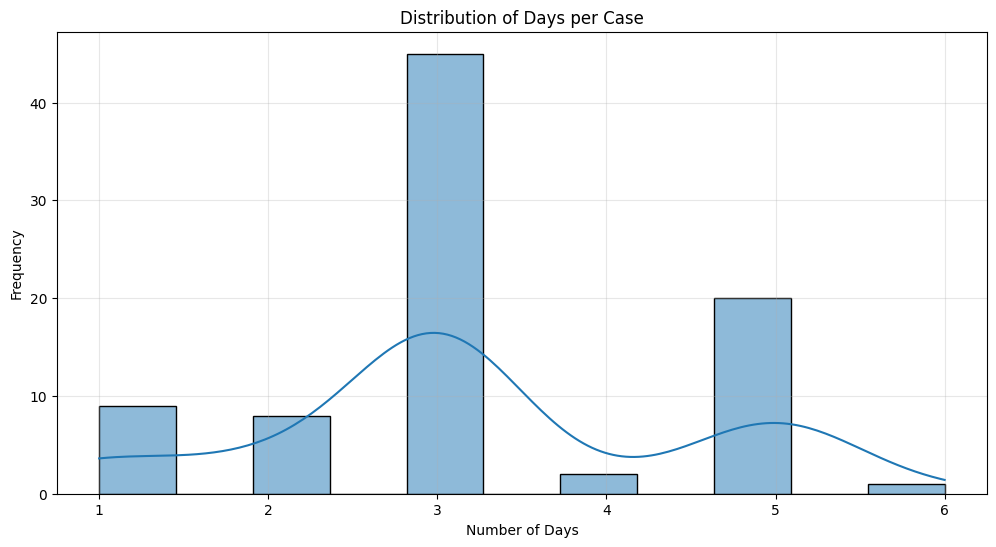


Class distribution:


class
large_bowel    38496
small_bowel    38496
stomach        38496
Name: count, dtype: int64

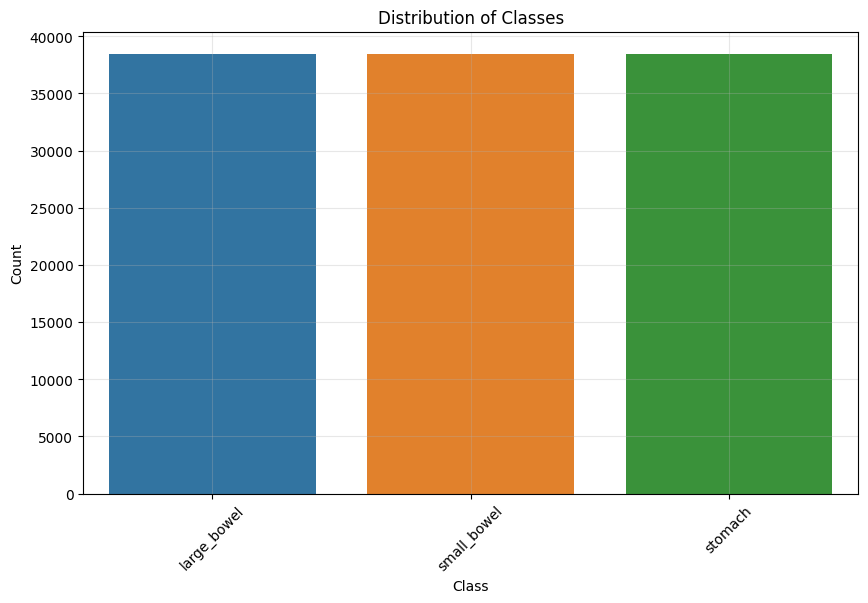

Image metadata statistics:


,case_id,day,slice_id,width,height,x_spacing,y_spacing
count,100.0,100.0,100.000000,100.0,100.0,100.0,100.0
mean,36.0,14.0,72.410000,266.0,266.0,1.5,1.5
std,0.0,0.0,41.629218,0.0,0.0,0.0,0.0
min,36.0,14.0,1.000000,266.0,266.0,1.5,1.5
25%,36.0,14.0,34.750000,266.0,266.0,1.5,1.5
50%,36.0,14.0,72.500000,266.0,266.0,1.5,1.5
75%,36.0,14.0,106.250000,266.0,266.0,1.5,1.5
max,36.0,14.0,144.000000,266.0,266.0,1.5,1.5


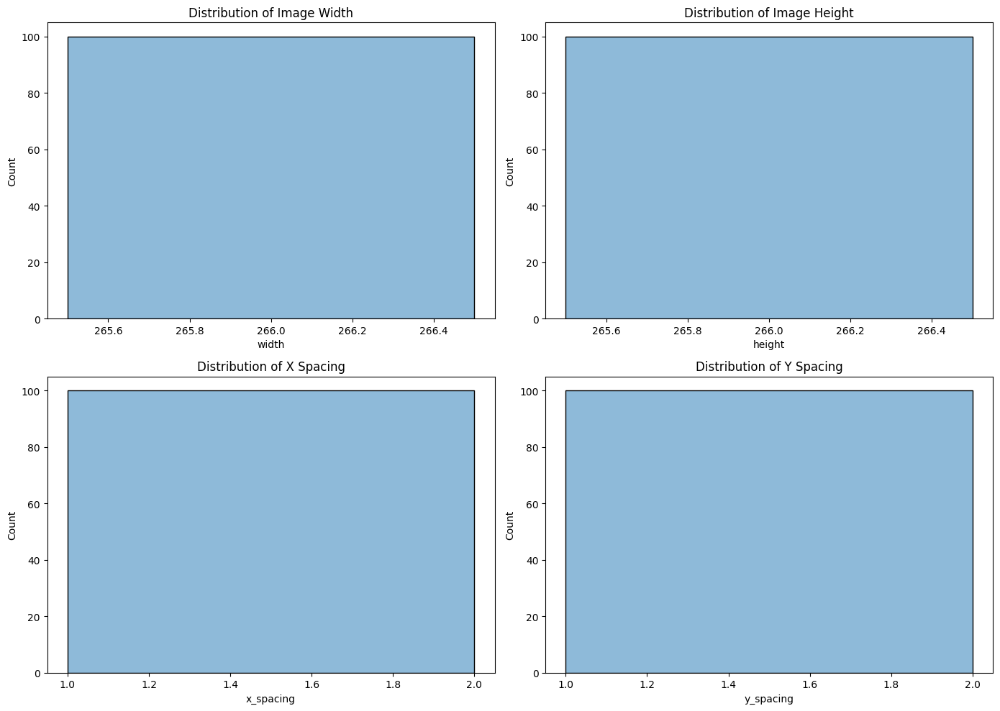

Percentage of non-empty masks by class:


class
large_bowel    36.588217
small_bowel    29.096530
stomach        22.410121
Name: has_mask, dtype: float64

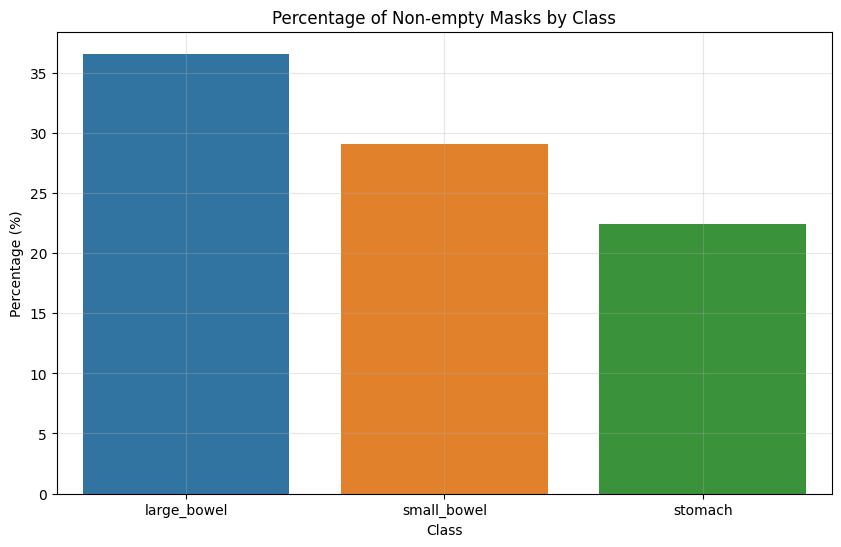


Mask size statistics by class:


,count,mean,std,min,25%,50%,75%,max
class,,,,,,,,
large_bowel,14085.0,1557.229535,1104.318866,11.0,745.0,1312.0,2088.0,6964.0
small_bowel,11201.0,1792.747255,1168.369544,29.0,986.0,1600.0,2422.0,8025.0
stomach,8627.0,1289.190565,1031.869933,12.0,552.0,962.0,1757.0,6917.0


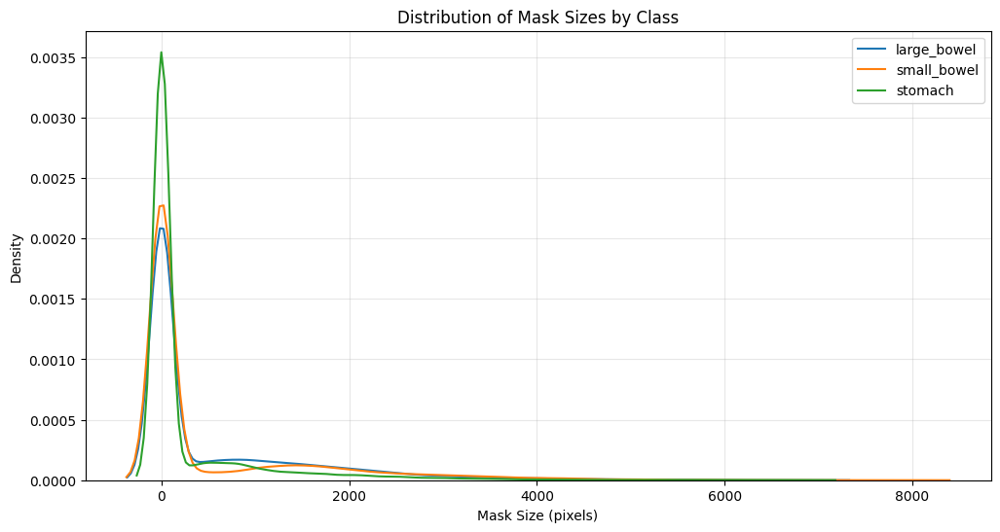


Visualizing sample images and their masks:


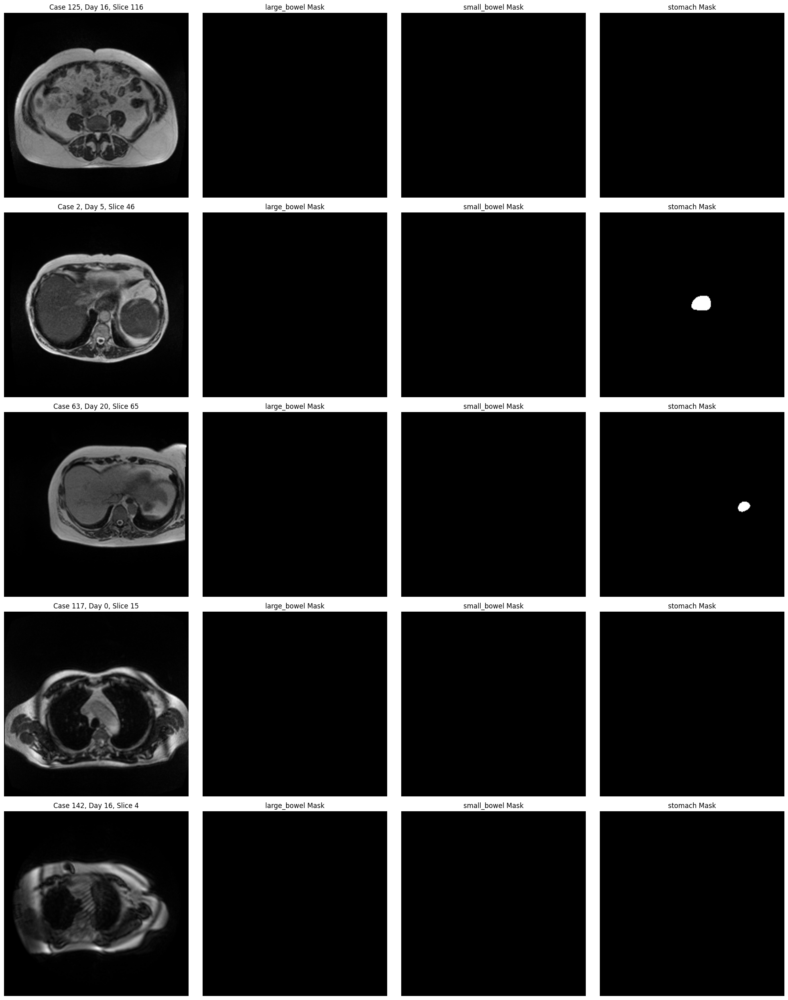


EDA completed!


In [10]:
def main_eda():
    """Main function to run the EDA"""
    print("=" * 50)
    print("Starting Exploratory Data Analysis for GI Tract Image Segmentation")
    print("=" * 50)
    
    # Load data
    df = load_data()
    
    # Explore dataset structure
    cases, days = explore_dataset_structure(df)
    
    # Analyze image properties
    analyze_image_properties()
    
    # Analyze masks
    analyze_masks(df)
    
    # Visualize images and masks
    print("\nVisualizing sample images and their masks:")
    visualize_images_and_masks(df, num_samples=5)
    
    print("\nEDA completed!")

if __name__ == "__main__":
    main_eda()

# 3D Structure Analysis

Examine the 3D structure of the scans by analyzing consecutive slices from the same case and day, as this will be important for the 3D Hausdorff distance calculation

The 3D plots are visualization methods to help understand the three-dimensional structure of the organs across multiple slices. Let me explain what each 3D plot is showing:

First 3D Plot (Voxel Visualization):

This plot uses the voxels function to create a 3D volumetric representation of the organ
Each "cube" or voxel represents a positive mask value (where the organ is present)
The red semi-transparent blocks show the 3D shape and volume of the organ across slices
The Z-axis represents the slice number (depth), while X and Y represent the 2D coordinates in each slice.
This visualization helps us see how the organ's shape extends through the 3D space of the scan


Second 3D Plot (Contour Visualization):

This plot shows the boundaries (contours) of the organ in each slice
The red lines represent the outline of the organ in each slice
Each "layer" along the Z-axis corresponds to a different slice in the scan
By connecting these contours across slices, you can see how the organ's boundary changes through the 3D volume.
This approach is particularly useful for visualizing hollow organs or structures with complex shapes


These 3D visualizations are important for this project because the evaluation includes a 3D Hausdorff distance metric, which measures how similar the predicted 3D volumes are to the ground truth. By visualizing the 3D structure, you can better understand:

* How the organs extend across multiple slices
* The spatial relationships between slices
* The overall shape and volume of each organ in three dimensions

The red color is used to highlight the organ boundaries or volumes, making them stand out from the background. The semi-transparent rendering in the first plot allows us to see internal structures that might otherwise be hidden.
These visualizations help bridge the gap between the individual 2D slice segmentations and the full 3D structure that needs to be accurately predicted in this project.

In [11]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import cv2
from tqdm.notebook import tqdm
from matplotlib import cm
import warnings
warnings.filterwarnings("ignore")


In [12]:
DATA_DIR = '/kaggle/input/uw-madison-gi-tract-image-segmentation'
TRAIN_DIR = os.path.join(DATA_DIR, 'train')
TRAIN_CSV = os.path.join(DATA_DIR, 'train.csv')


In [13]:
# Color maps for different organs
ORGAN_COLORS = {
    'large_bowel': 'coral',
    'small_bowel': 'springgreen',
    'stomach': 'dodgerblue'
}

In [14]:
def decode_rle(rle, shape=(266, 266)):
    """Decode RLE to mask"""
    if pd.isna(rle):
        return np.zeros(shape)
    
    # Check if the string is empty
    if not rle or rle.strip() == '':
        return np.zeros(shape)
    
    try:
        s = rle.split()
        starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
        starts -= 1
        ends = starts + lengths
        img = np.zeros(shape[0] * shape[1], dtype=np.uint8)
        
        for lo, hi in zip(starts, ends):
            if lo < img.shape[0] and hi <= img.shape[0]:  # Add bounds check
                img[lo:hi] = 1
        
        return img.reshape(shape)
    except Exception as e:
        print(f"Error decoding RLE: {str(e)}, RLE: {rle}")
        return np.zeros(shape)


In [15]:
def load_image(path):
    """Load and normalize image"""
    try:
        img = cv2.imread(path, cv2.IMREAD_UNCHANGED)
        if img is None:
            print(f"Could not load image from {path}")
            return np.zeros((266, 266), dtype=np.uint8)
        
        # Normalize to 0-255 for display
        if img.max() > 0:
            img = ((img - img.min()) / (img.max() - img.min()) * 255).astype(np.uint8)
        
        return img
    except Exception as e:
        print(f"Error loading image: {str(e)}")
        return np.zeros((266, 266), dtype=np.uint8)

In [16]:
def create_enhanced_3d_visualizations(masks_3d, case_id, day_id, organ_class):
    """Create enhanced 3D visualizations for a set of masks"""
    if len(masks_3d) < 3:
        print("Not enough slices for 3D visualization")
        return
    
    try:
        # Create a downsampled version for faster visualization
        downsampled_masks = []
        for mask in masks_3d:
            # Downsample to 64x64
            mask_small = cv2.resize(mask, (64, 64), interpolation=cv2.INTER_NEAREST)
            downsampled_masks.append(mask_small)
        
        # Create 3D array
        mask_volume = np.stack(downsampled_masks, axis=0)
        
        # Get organ-specific color
        color = ORGAN_COLORS.get(organ_class, 'red')
        
        # VISUALIZATION 1: Enhanced 3D Surface Plot
        fig = plt.figure(figsize=(12, 10))
        ax = fig.add_subplot(111, projection='3d')
        
        # Find all points where mask is positive
        z, y, x = np.where(mask_volume > 0)
        
        if len(z) > 0:  # Only plot if we have points
            # Create a scatter plot with alpha based on density
            scatter = ax.scatter(
                z, x, y,  # Note the reordering to make the visualization more intuitive
                c=z,      # Color by slice (depth)
                cmap=cm.coolwarm,
                marker='o',
                s=20,     # Point size
                alpha=0.7,
                edgecolors='none'
            )
            
            # Add labels and title
            ax.set_title(f"3D {organ_class.replace('_', ' ').title()} Visualization\nCase {case_id}, Day {day_id}", 
                         fontsize=14, fontweight='bold')
            ax.set_xlabel('Slice Number (Depth)', fontsize=12, labelpad=10)
            ax.set_ylabel('Width', fontsize=12, labelpad=10)
            ax.set_zlabel('Height', fontsize=12, labelpad=10)
            
            # Add colorbar
            cbar = plt.colorbar(scatter, ax=ax, shrink=0.6, aspect=8)
            cbar.set_label('Slice Depth', fontsize=12)
            
            # Adjust the view angle for better visualization
            ax.view_init(elev=30, azim=45)
            
            # Add a text explanation
            fig.text(0.02, 0.02, 
                    f"This visualization shows the 3D structure of the {organ_class.replace('_', ' ')}.\n"
                    "Each point represents a pixel where the organ is present.\n"
                    "Color indicates the slice depth (blue → red = shallow → deep).", 
                    fontsize=11, wrap=True)
        else:
            ax.text(0.5, 0.5, 0.5, "No data points to visualize", 
                   ha='center', va='center', fontsize=14)
        
        plt.tight_layout()
        plt.show()
        
        # VISUALIZATION 2: Multi-slice 3D visualization
        fig = plt.figure(figsize=(12, 10))
        ax = fig.add_subplot(111, projection='3d')
        
        # Get dimensions
        n_slices, height, width = mask_volume.shape
        
        # Create grid for each slice
        x, y = np.meshgrid(np.arange(width), np.arange(height))
        
        # Plot each slice with its mask
        for i, mask in enumerate(downsampled_masks):
            # Skip empty slices
            if not np.any(mask):
                continue
                
            # Plot the slice surface
            z = np.ones_like(mask) * i
            ax.plot_surface(
                z, x, y,  # Slice depth, X coordinate, Y coordinate
                rstride=2, cstride=2,  # Stride for better performance
                facecolors=cm.viridis(mask),  # Color based on mask values
                alpha=0.5,  # Transparency
                shade=True,
                edgecolor='none'
            )
            
            # Add contour lines for each slice
            contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            for contour in contours:
                if len(contour) > 5:  # Only plot if there are enough points
                    contour = contour.squeeze()
                    z_contour = np.ones(contour.shape[0]) * i
                    ax.plot(z_contour, contour[:, 0], contour[:, 1], color=color, linewidth=2)
        
        # Add explanatory text
        ax.set_title(f"3D Multi-slice View of {organ_class.replace('_', ' ').title()}\nCase {case_id}, Day {day_id}", 
                     fontsize=14, fontweight='bold')
        ax.set_xlabel('Slice Number (Depth)', fontsize=12, labelpad=10)
        ax.set_ylabel('Width', fontsize=12, labelpad=10)
        ax.set_zlabel('Height', fontsize=12, labelpad=10)
        
        # Add explanation
        fig.text(0.02, 0.02, 
                f"This visualization shows each slice as a semi-transparent surface.\n"
                f"The {color} lines outline the {organ_class.replace('_', ' ')} boundaries in each slice.\n"
                "By stacking the slices, you can see how the organ's shape changes through the scan.",
                fontsize=11, wrap=True)
        
        # Adjust view
        ax.view_init(elev=35, azim=45)
        
        plt.tight_layout()
        plt.show()
        
        # VISUALIZATION 3: Volume Rendering
        fig = plt.figure(figsize=(12, 10))
        ax = fig.add_subplot(111, projection='3d')
        
        # Create 3D volume with voxels
        mask_volume_padded = np.pad(mask_volume, pad_width=1, mode='constant')
        
        # Create a colormap with organ-specific color and transparency
        rgba_colors = np.zeros(mask_volume_padded.shape + (4,))
        
        # Set color and alpha for the organ
        if organ_class == 'large_bowel':
            rgba_colors[mask_volume_padded > 0] = [1, 0.4, 0.4, 0.6]  # Semi-transparent red
        elif organ_class == 'small_bowel':
            rgba_colors[mask_volume_padded > 0] = [0.4, 1, 0.4, 0.6]  # Semi-transparent green
        else:  # stomach
            rgba_colors[mask_volume_padded > 0] = [0.4, 0.4, 1, 0.6]  # Semi-transparent blue
            
        # Create voxel visualization
        ax.voxels(mask_volume_padded, facecolors=rgba_colors, edgecolors='k', linewidth=0.1)
        
        # Add title and labels
        ax.set_title(f"3D Volume Rendering of {organ_class.replace('_', ' ').title()}\nCase {case_id}, Day {day_id}", 
                     fontsize=14, fontweight='bold')
        ax.set_xlabel('Slice Number (Depth)', fontsize=12, labelpad=10)
        ax.set_ylabel('Width', fontsize=12, labelpad=10)
        ax.set_zlabel('Height', fontsize=12, labelpad=10)
        
        # Add explanatory text
        fig.text(0.02, 0.02, 
                f"This visualization shows the 3D volume of the {organ_class.replace('_', ' ')}.\n"
                "Each cube (voxel) represents a 3D pixel where the organ is present.\n"
                "This helps understand the overall 3D shape of the organ across multiple slices.",
                fontsize=11, wrap=True)
        
        # Adjust view
        ax.view_init(elev=30, azim=30)
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Error creating 3D visualization: {str(e)}")

In [17]:
def visualize_image_set():
    """Visualize a set of images and masks from specific cases"""
    # Load the CSV
    df = pd.read_csv(TRAIN_CSV)
    print(f"Total rows in CSV: {len(df)}")
    
    # Extract case, day, slice from the id
    df[['case', 'day', 'slice']] = df['id'].str.extract(r'case(\d+)_day(\d+)_slice_(\d+)')
    df['case'] = df['case'].astype(int)
    df['day'] = df['day'].astype(int)
    df['slice'] = df['slice'].astype(int)
    
    # Find cases with good mask coverage
    case_mask_counts = df[~df['segmentation'].isna()].groupby(['case', 'day', 'class']).size().reset_index(name='mask_count')
    good_cases = case_mask_counts[case_mask_counts['mask_count'] > 5].sort_values('mask_count', ascending=False)
    
    print("Cases with good mask coverage:")
    display(good_cases.head(10))
    
    # Choose the top case for each class
    selected_cases = []
    for organ_class in ['large_bowel', 'small_bowel', 'stomach']:
        class_cases = good_cases[good_cases['class'] == organ_class]
        if len(class_cases) > 0:
            selected_cases.append(class_cases.iloc[0])
    
    # If no good cases found, use default cases
    if len(selected_cases) == 0:
        print("No cases with good mask coverage found. Using default examples.")
        # These are placeholder values
        selected_cases = [
            {'case': 123, 'day': 20, 'class': 'large_bowel'},
            {'case': 126, 'day': 30, 'class': 'small_bowel'},
            {'case': 148, 'day': 53, 'class': 'stomach'}
        ]
    
    # For each selected case
    for case_info in selected_cases:
        case_id = case_info['case']
        day_id = case_info['day']
        organ_class = case_info['class']
        
        print(f"\nVisualizing {organ_class} for Case {case_id}, Day {day_id}")
        
        # Get slices with masks for this case/day/class
        case_slices = df[(df['case'] == case_id) & 
                          (df['day'] == day_id) & 
                          (df['class'] == organ_class) & 
                          (~df['segmentation'].isna())]['slice'].unique()
        
        if len(case_slices) == 0:
            print(f"No slices with masks found for this case/day/class.")
            continue
            
        case_slices = sorted(case_slices)
        print(f"Found {len(case_slices)} slices with masks.")
        
        # Select a subset of slices for visualization
        if len(case_slices) > 5:
            selected_slices = np.linspace(0, len(case_slices)-1, 5, dtype=int)
            visualize_slices = [case_slices[i] for i in selected_slices]
        else:
            visualize_slices = case_slices
        
        # Create a figure
        fig, axes = plt.subplots(2, len(visualize_slices), figsize=(4*len(visualize_slices), 8))
        
        # For each slice
        masks_3d = []
        for i, slice_id in enumerate(visualize_slices):
            # Construct image path
            img_path = f"{TRAIN_DIR}/case{case_id}/case{case_id}_day{day_id}/scans/slice_{slice_id:04d}_266_266_1.50_1.50.png"
            
            # Load image
            img = load_image(img_path)
            
            # Display image
            axes[0, i].imshow(img, cmap='gray')
            axes[0, i].set_title(f"Slice {slice_id}")
            axes[0, i].axis('off')
            
            # Get mask RLE
            mask_row = df[(df['case'] == case_id) & 
                          (df['day'] == day_id) & 
                          (df['slice'] == slice_id) & 
                          (df['class'] == organ_class)]
            
            if len(mask_row) > 0 and not pd.isna(mask_row.iloc[0]['segmentation']):
                rle = mask_row.iloc[0]['segmentation']
                mask = decode_rle(rle)
                masks_3d.append(mask)
            else:
                mask = np.zeros((266, 266), dtype=np.uint8)
                masks_3d.append(mask)
            
            # Display mask
            axes[1, i].imshow(mask, cmap='viridis')
            axes[1, i].set_title(f"{organ_class} Mask")
            axes[1, i].axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Create enhanced 3D visualizations
        if len(masks_3d) >= 3:
            create_enhanced_3d_visualizations(masks_3d, case_id, day_id, organ_class)


In [18]:
def visualize_single_cases():
    """Visualize a single slice with different organs"""
    # Load the CSV
    df = pd.read_csv(TRAIN_CSV)
    
    # Extract case, day, slice from the id
    df[['case', 'day', 'slice']] = df['id'].str.extract(r'case(\d+)_day(\d+)_slice_(\d+)')
    df['case'] = df['case'].astype(int)
    df['day'] = df['day'].astype(int)
    df['slice'] = df['slice'].astype(int)
    
    # Find slices with all three organs
    slice_counts = df[~df['segmentation'].isna()].groupby(['case', 'day', 'slice']).size()
    good_slices = slice_counts[slice_counts == 3].reset_index()
    
    if len(good_slices) == 0:
        print("No slices with all three organs found.")
        # Try to find slices with at least two organs
        good_slices = slice_counts[slice_counts >= 2].reset_index().head(1)
        if len(good_slices) == 0:
            print("No slices with multiple organs found either.")
            return
    
    print(f"Found {len(good_slices)} slices with all three organs.")
    
    # Select a random good slice
    selected_slice = good_slices.iloc[0]
    case_id = selected_slice['case']
    day_id = selected_slice['day']
    slice_id = selected_slice['slice']
    
    print(f"Visualizing Case {case_id}, Day {day_id}, Slice {slice_id}")
    
    # Construct image path
    img_path = f"{TRAIN_DIR}/case{case_id}/case{case_id}_day{day_id}/scans/slice_{slice_id:04d}_266_266_1.50_1.50.png"
    
    # Load image
    img = load_image(img_path)
    
    # Create figure
    fig, axes = plt.subplots(1, 5, figsize=(20, 4))
    
    # Display original image
    axes[0].imshow(img, cmap='gray')
    axes[0].set_title("Original Image", fontsize=14)
    axes[0].axis('off')
    
    # Create a combined mask
    combined_mask = np.zeros((266, 266, 3), dtype=np.float32)
    
    # For each organ, get and display mask
    i = 1
    for organ_class in ['large_bowel', 'small_bowel', 'stomach']:
        # Get mask RLE
        mask_row = df[(df['case'] == case_id) & 
                      (df['day'] == day_id) & 
                      (df['slice'] == slice_id) & 
                      (df['class'] == organ_class)]
        
        if len(mask_row) > 0 and not pd.isna(mask_row.iloc[0]['segmentation']):
            rle = mask_row.iloc[0]['segmentation']
            mask = decode_rle(rle)
            
            # Add to combined mask with organ-specific color
            if organ_class == 'large_bowel':
                combined_mask[:, :, 0] += mask  # Red channel
            elif organ_class == 'small_bowel':
                combined_mask[:, :, 1] += mask  # Green channel
            else:  # stomach
                combined_mask[:, :, 2] += mask  # Blue channel
            
            # Display individual mask
            cmap = plt.cm.get_cmap('viridis')
            axes[i].imshow(mask, cmap=cmap)
            axes[i].set_title(f"{organ_class.replace('_', ' ').title()}", fontsize=14)
            axes[i].axis('off')
            i += 1
        else:
            axes[i].text(0.5, 0.5, f"No {organ_class} mask", 
                         ha='center', va='center', fontsize=14)
            axes[i].axis('off')
            i += 1
    
    # Normalize combined mask
    max_val = combined_mask.max()
    if max_val > 0:
        combined_mask = combined_mask / max_val
    
    # Display combined mask
    axes[4].imshow(combined_mask)
    axes[4].set_title("Combined Masks (RGB)", fontsize=14)
    
    # Add legend for combined mask
    legend_elements = [
        plt.Line2D([0], [0], marker='o', color='w', 
                   markerfacecolor='red', markersize=10, label='Large Bowel'),
        plt.Line2D([0], [0], marker='o', color='w', 
                   markerfacecolor='green', markersize=10, label='Small Bowel'),
        plt.Line2D([0], [0], marker='o', color='w', 
                   markerfacecolor='blue', markersize=10, label='Stomach')
    ]
    axes[4].legend(handles=legend_elements, loc='lower right')
    axes[4].axis('off')
    
    plt.tight_layout()
    plt.show()


Enhanced GI Tract Image Visualization

Visualizing individual slices with multiple organs:
Found 3201 slices with all three organs.
Visualizing Case 2, Day 1, Slice 78


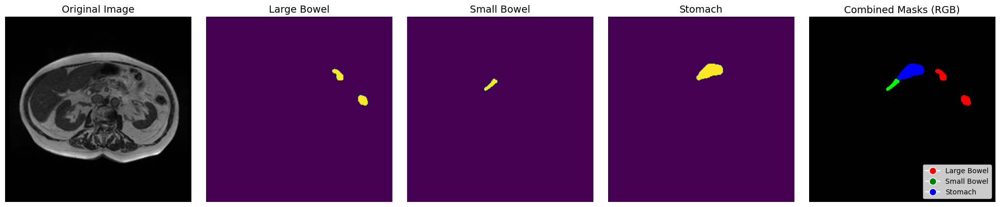


Visualizing image sets and 3D structures for each organ:
Total rows in CSV: 115488
Cases with good mask coverage:


,case,day,class,mask_count
629,130,0,large_bowel,88
302,65,0,large_bowel,79
260,54,0,large_bowel,79
650,131,23,large_bowel,78
689,138,11,large_bowel,77
665,134,21,large_bowel,76
284,58,0,large_bowel,74
6,2,3,large_bowel,74
575,122,18,large_bowel,73
186,36,16,large_bowel,72



Visualizing large_bowel for Case 130, Day 0
Found 88 slices with masks.


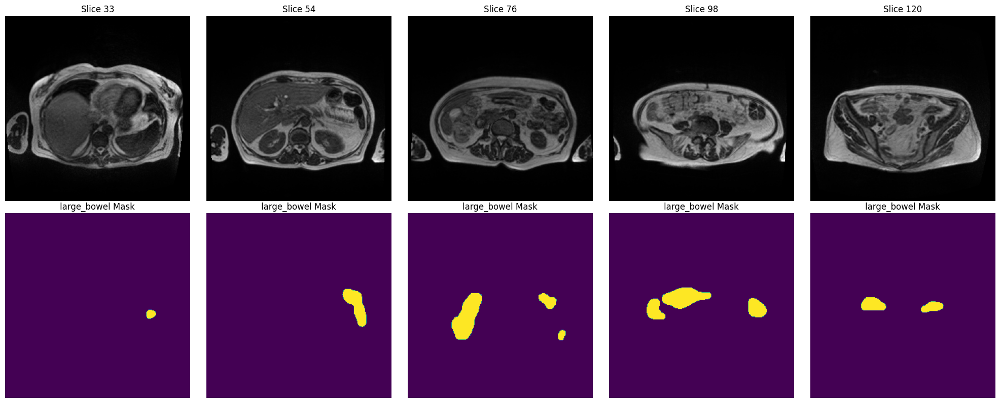

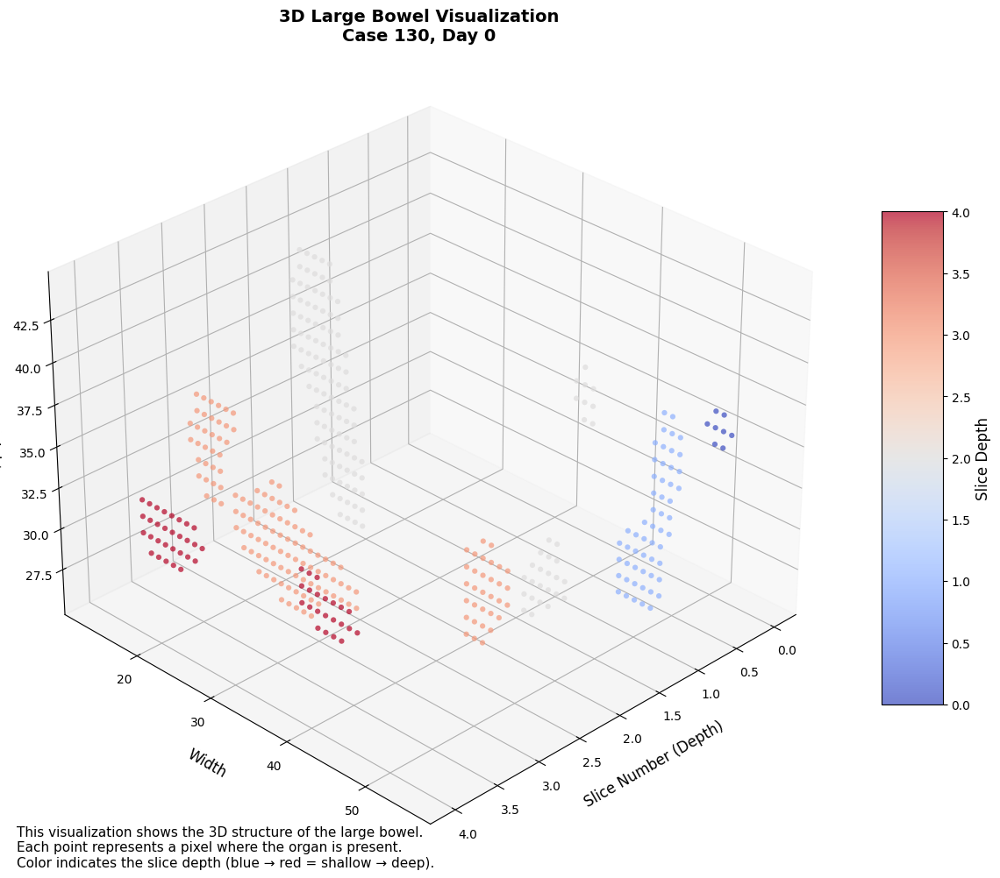

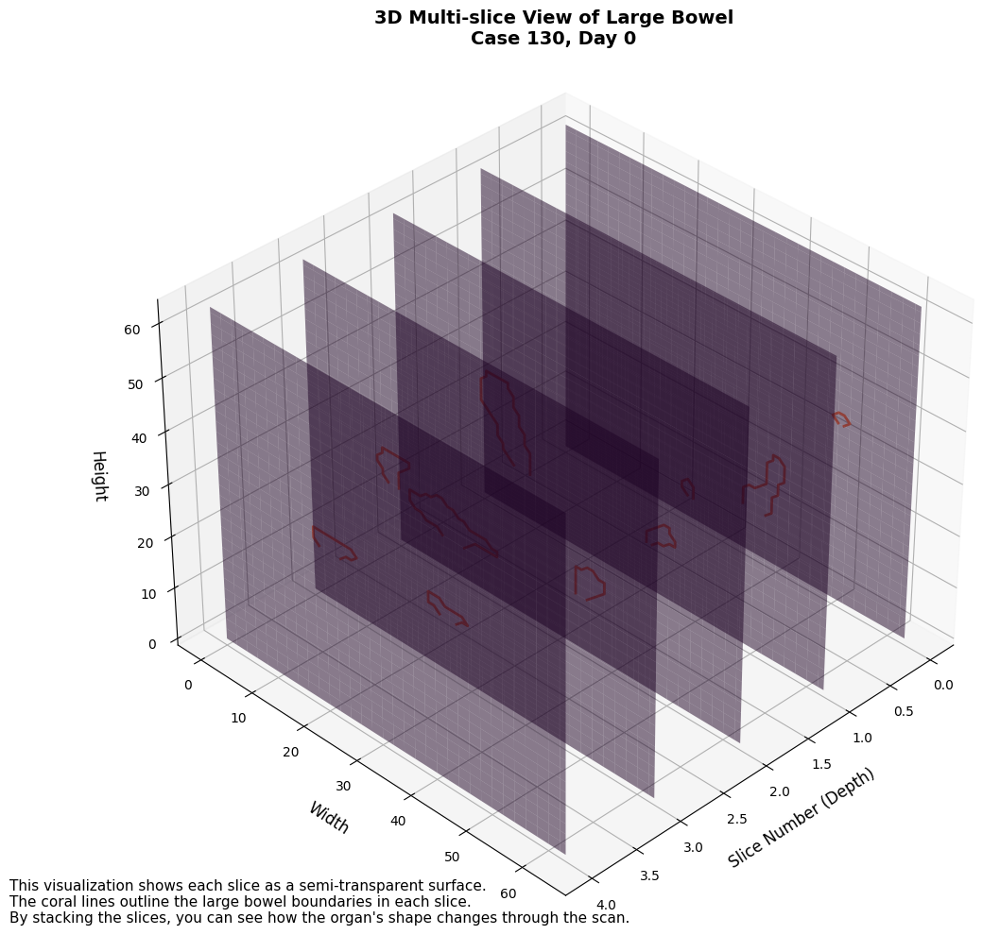

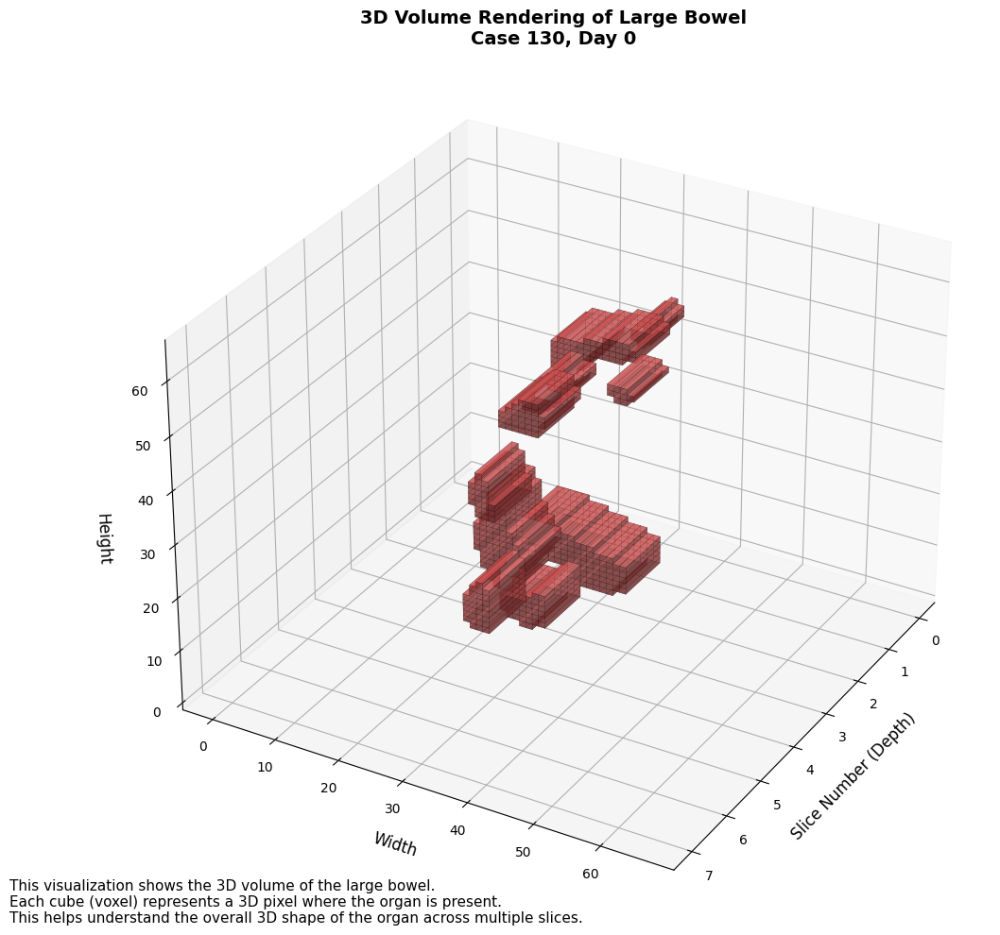


Visualizing small_bowel for Case 130, Day 0
Found 71 slices with masks.


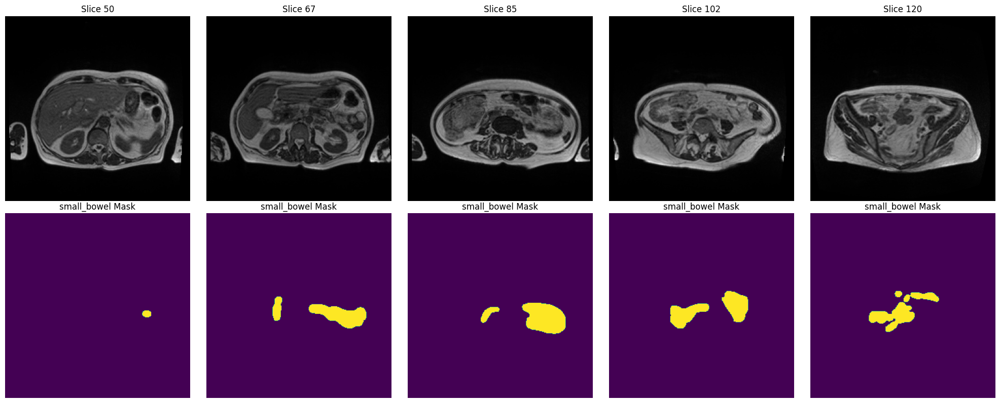

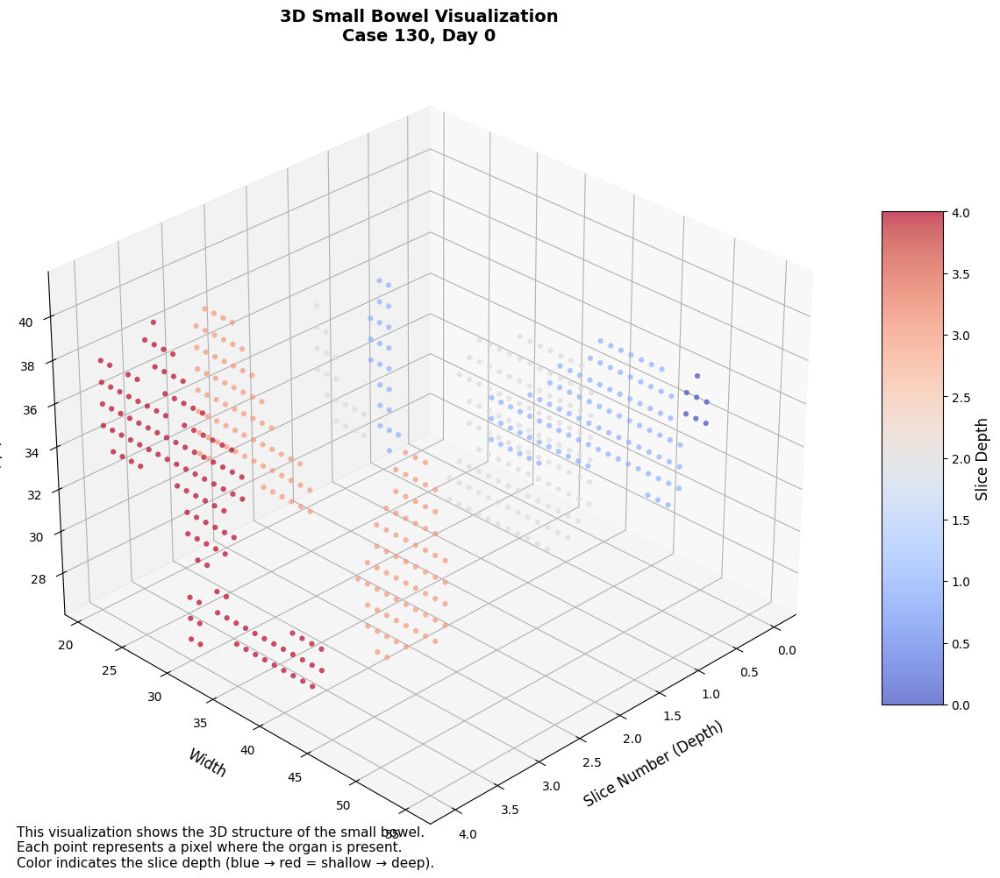

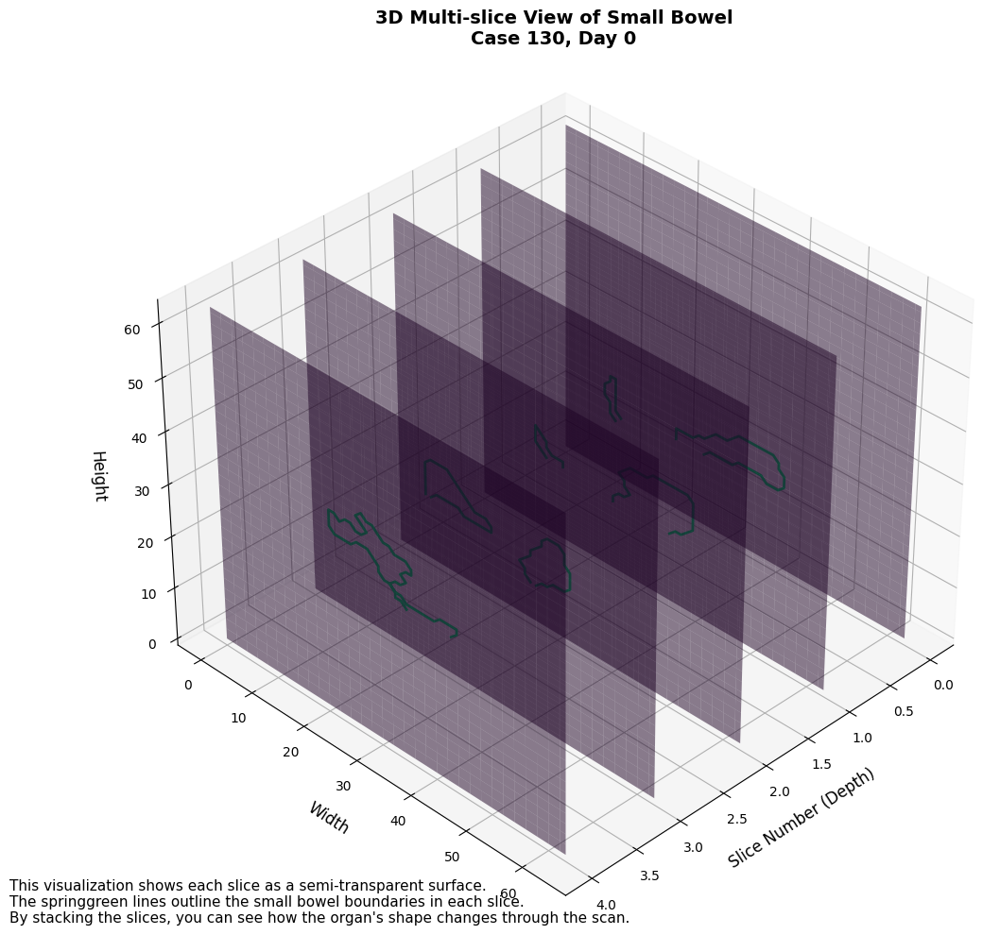

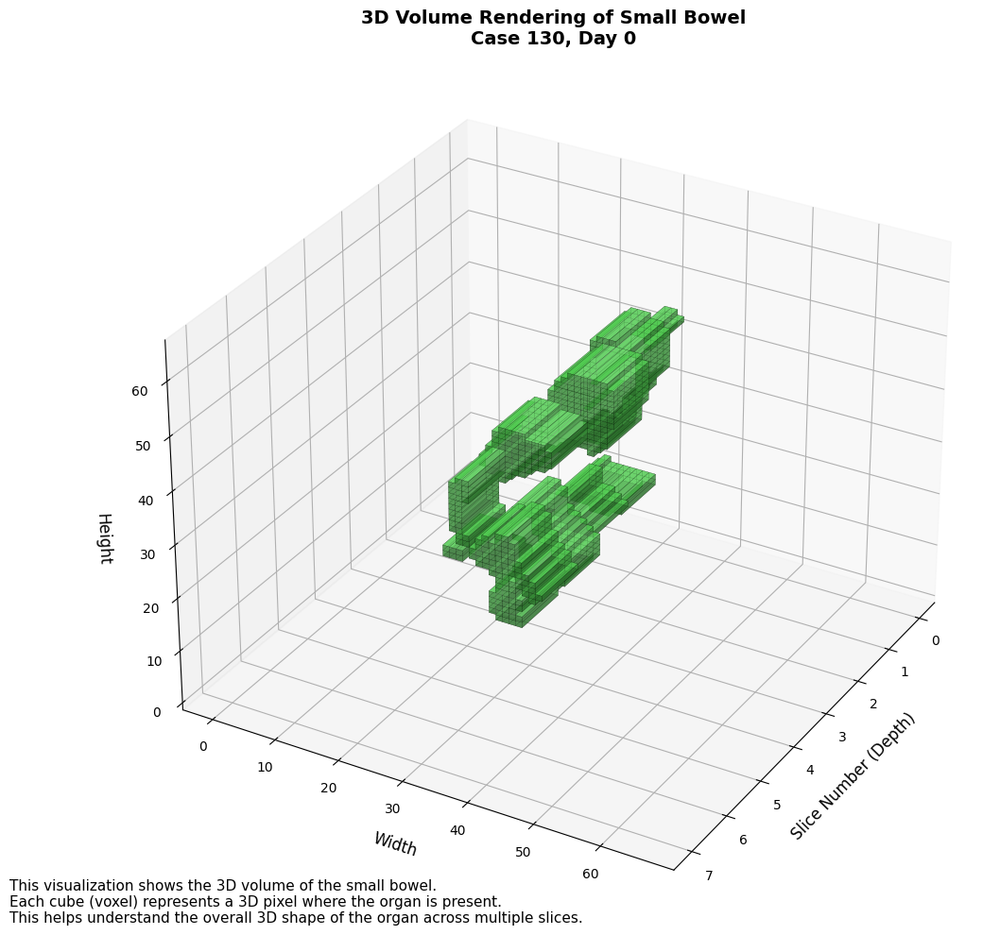


Visualizing stomach for Case 90, Day 22
Found 52 slices with masks.


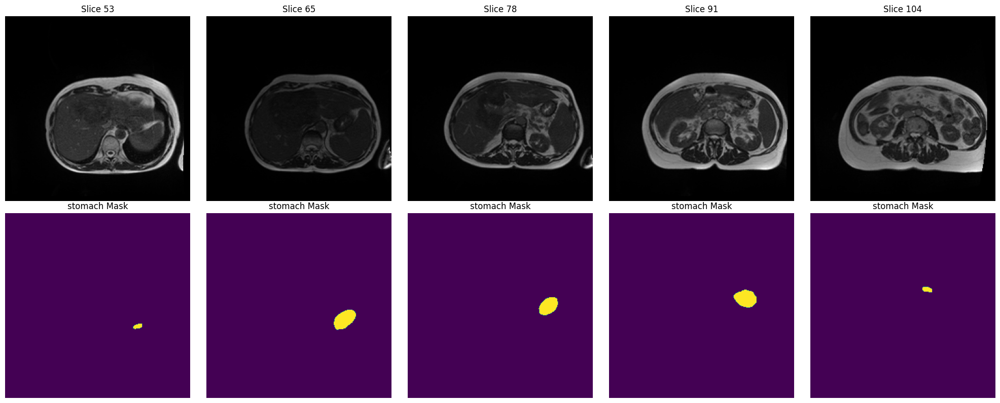

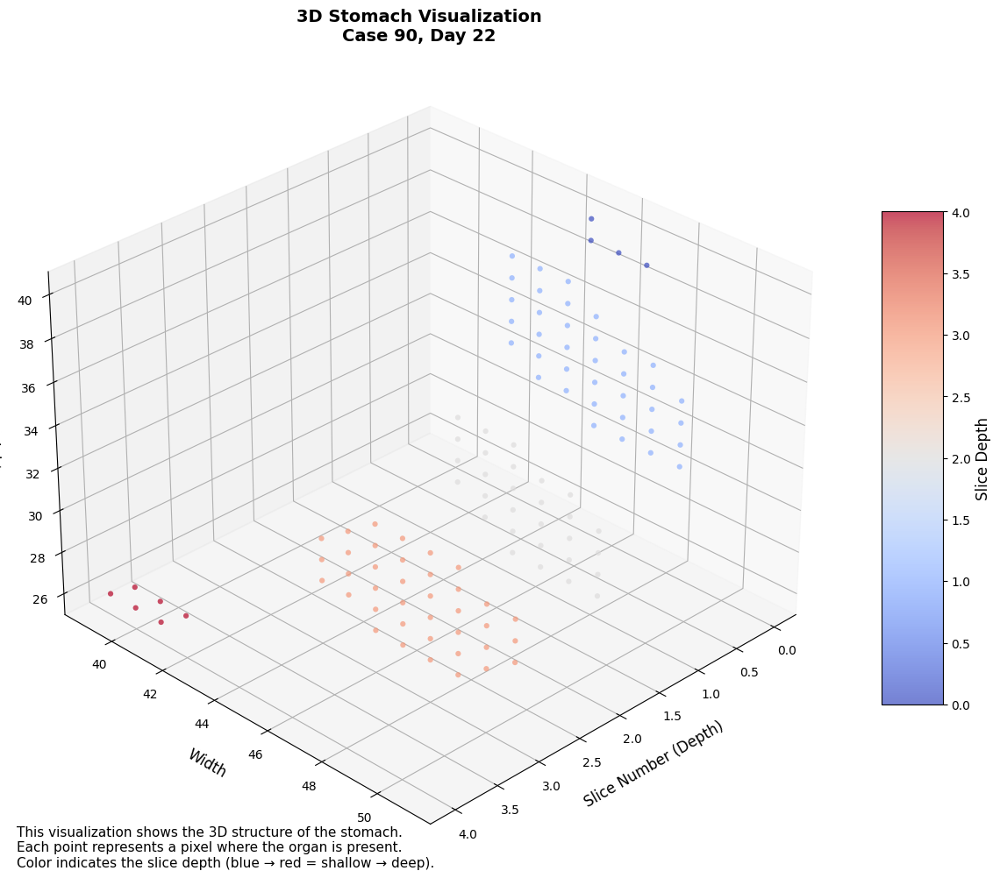

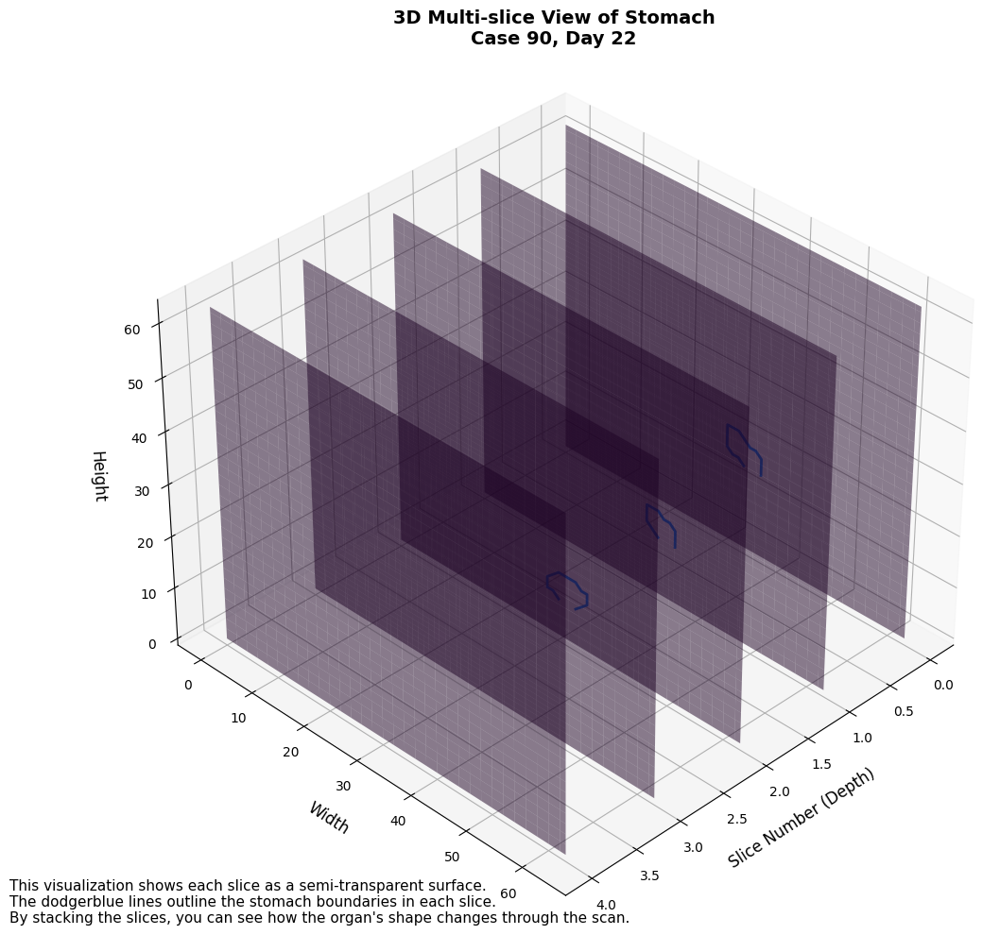

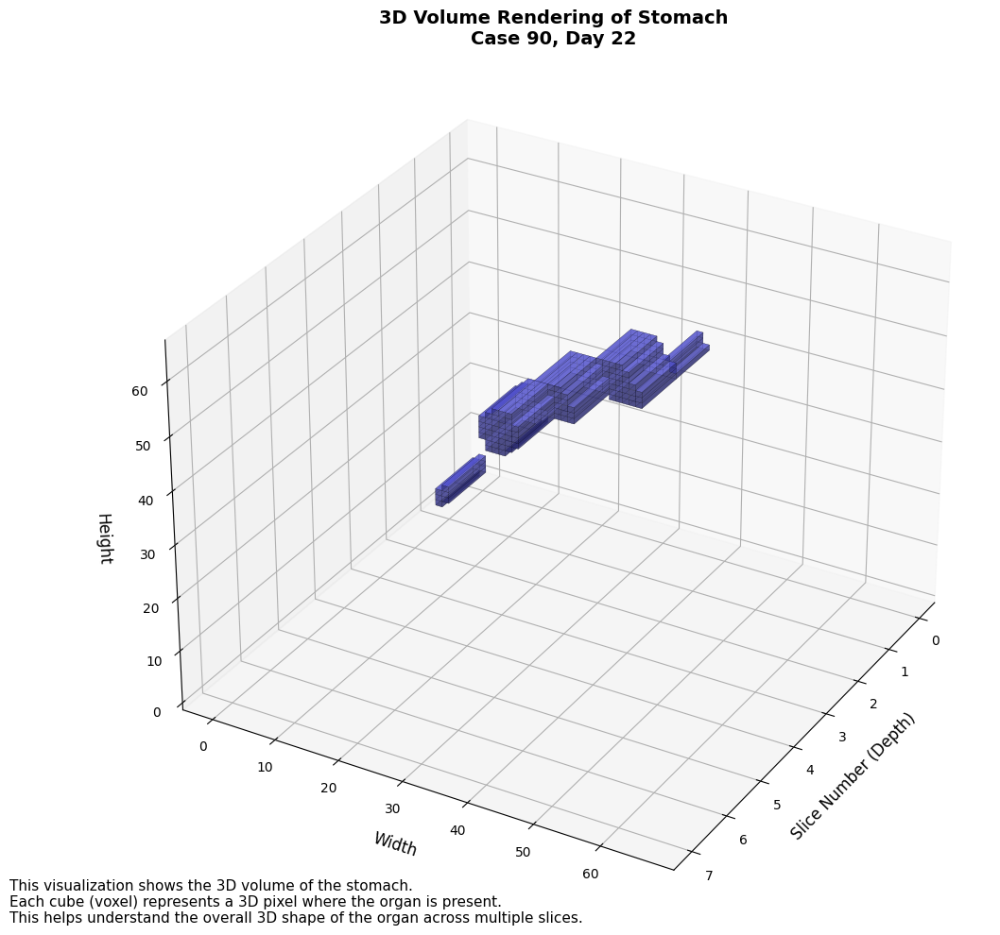


Visualization completed!


In [19]:
def main_visualization():
    """Main function for enhanced visualization"""
    print("=" * 50)
    print("Enhanced GI Tract Image Visualization")
    print("=" * 50)
    
    # Visualize individual cases
    print("\nVisualizing individual slices with multiple organs:")
    visualize_single_cases()
    
    # Visualize image sets
    print("\nVisualizing image sets and 3D structures for each organ:")
    visualize_image_set()
    
    print("\nVisualization completed!")

if __name__ == "__main__":
    main_visualization()

# 3D Bowel Visualization

In [20]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import cv2
from matplotlib import cm
from matplotlib.colors import ListedColormap
import warnings
warnings.filterwarnings("ignore")

In [21]:
DATA_DIR = '/kaggle/input/uw-madison-gi-tract-image-segmentation'
TRAIN_DIR = os.path.join(DATA_DIR, 'train')
TRAIN_CSV = os.path.join(DATA_DIR, 'train.csv')

In [22]:
def decode_rle(rle, shape=(266, 266)):
    """Decode RLE to mask"""
    if pd.isna(rle):
        return np.zeros(shape)
    
    # Check if the string is empty
    if not rle or rle.strip() == '':
        return np.zeros(shape)
    
    try:
        s = rle.split()
        starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
        starts -= 1
        ends = starts + lengths
        img = np.zeros(shape[0] * shape[1], dtype=np.uint8)
        
        for lo, hi in zip(starts, ends):
            if lo < img.shape[0] and hi <= img.shape[0]:
                img[lo:hi] = 1
        
        return img.reshape(shape)
    except Exception as e:
        print(f"Error decoding RLE: {str(e)}")
        return np.zeros(shape)

In [23]:
def get_organ_masks_for_case(df, case_id, day_id, organ_class, max_slices=15):
    """Get organ masks for a specific case, day, and class"""
    # Get slices with masks for this case/day/class
    mask_slices = df[(df['case'] == case_id) & 
                    (df['day'] == day_id) & 
                    (df['class'] == organ_class) & 
                    (~df['segmentation'].isna())]['slice'].unique()
    
    if len(mask_slices) == 0:
        print(f"No masks found for Case {case_id}, Day {day_id}, Class {organ_class}")
        return [], []
    
    mask_slices = sorted(mask_slices)
    print(f"Found {len(mask_slices)} slices with {organ_class} masks.")
    
    # If too many slices, select a subset
    if len(mask_slices) > max_slices:
        # Choose evenly spaced slices
        indices = np.linspace(0, len(mask_slices)-1, max_slices, dtype=int)
        mask_slices = [mask_slices[i] for i in indices]
    
    # Get masks for selected slices
    masks = []
    slice_nums = []
    
    for slice_id in mask_slices:
        # Get RLE
        mask_row = df[(df['case'] == case_id) & 
                     (df['day'] == day_id) & 
                     (df['slice'] == slice_id) & 
                     (df['class'] == organ_class)]
        
        if len(mask_row) > 0 and not pd.isna(mask_row.iloc[0]['segmentation']):
            rle = mask_row.iloc[0]['segmentation']
            mask = decode_rle(rle)
            
            # If mask has content, add it
            if np.sum(mask) > 0:
                masks.append(mask)
                slice_nums.append(slice_id)
    
    return masks, slice_nums


In [24]:
def visualize_3d_bowel():
    """Create 3D visualizations focusing on bowel structures"""
    print("Loading data for 3D bowel visualization...")
    
    # Load the CSV
    df = pd.read_csv(TRAIN_CSV)
    
    # Extract case, day, slice from the id
    df[['case', 'day', 'slice']] = df['id'].str.extract(r'case(\d+)_day(\d+)_slice_(\d+)')
    df['case'] = df['case'].astype(int)
    df['day'] = df['day'].astype(int)
    df['slice'] = df['slice'].astype(int)
    
    # Find good cases for each bowel class
    bowel_classes = ['large_bowel', 'small_bowel']
    
    # Get mask counts for each case/day/class
    case_mask_counts = df[~df['segmentation'].isna()].groupby(['case', 'day', 'class']).size().reset_index(name='mask_count')
    good_cases = case_mask_counts[case_mask_counts['mask_count'] > 10].sort_values('mask_count', ascending=False)
    
    # Filter for bowel classes
    good_bowel_cases = good_cases[good_cases['class'].isin(bowel_classes)]
    
    # Display some example cases
    print("Top cases with good bowel mask coverage:")
    display(good_bowel_cases.head(6))
    
    # Create 3D visualizations for the top cases of each bowel type
    visualized_classes = {}
    
    for organ_class in bowel_classes:
        class_cases = good_bowel_cases[good_bowel_cases['class'] == organ_class]
        
        if len(class_cases) == 0:
            print(f"No good cases found for {organ_class}")
            continue
        
        # Take the top 3 cases or less if fewer are available
        top_cases = class_cases.head(min(3, len(class_cases)))
        
        # Process each case
        for _, case_info in top_cases.iterrows():
            case_id = case_info['case']
            day_id = case_info['day']
            
            # Skip if we've already visualized this class 3 times
            class_key = organ_class
            visualized_classes[class_key] = visualized_classes.get(class_key, 0) + 1
            if visualized_classes[class_key] > 3:
                continue
                
            print(f"\nCreating 3D visualization for {organ_class}, Case {case_id}, Day {day_id}")
            
            # Get masks for this case
            masks, slice_nums = get_organ_masks_for_case(df, case_id, day_id, organ_class)
            
            if len(masks) < 3:
                print(f"Not enough masks with content for 3D visualization")
                continue
            
            # Create 3D visualization
            create_3d_bowel_visualization(masks, slice_nums, case_id, day_id, organ_class)


In [25]:
def create_3d_bowel_visualization(masks, slice_nums, case_id, day_id, organ_class):
    """Create 3D visualization for bowel structures"""
    if len(masks) < 3:
        print("Not enough masks for 3D visualization")
        return
    
    try:
        # Downsample masks for better performance
        downsampled_masks = []
        for mask in masks:
            # Reduce to 64x64 resolution
            mask_small = cv2.resize(mask, (64, 64), interpolation=cv2.INTER_NEAREST)
            downsampled_masks.append(mask_small)
        
        # Create color mappings for different organs - using more vibrant colormaps
        if organ_class == 'large_bowel':
            main_color = 'red'
            cmap = plt.cm.plasma  # More vibrant and visible colormap
        else:  # small_bowel
            main_color = 'green'
            cmap = plt.cm.viridis  # More vibrant and visible colormap
        
        # VISUALIZATION 1: 3D Surface Plot with Slice Depth
        fig = plt.figure(figsize=(12, 10))
        ax = fig.add_subplot(111, projection='3d')
        
        # Create a mesh for each slice
        for i, (mask, slice_id) in enumerate(zip(downsampled_masks, slice_nums)):
            # Get mask coordinates
            y, x = np.where(mask > 0)
            
            if len(x) > 0 and len(y) > 0:
                # Create z-coordinates (all same value for a slice)
                z = np.ones_like(x) * i
                
                # Plot as scatter with more vivid colors and larger point size
                ax.scatter(x, y, z, c=z, cmap=cmap, s=50, alpha=0.9, edgecolors='k', linewidths=0.3)
                
                # Add a text label for the slice number
                if i % 5 == 0:  # Label every 5th slice to avoid clutter
                    ax.text(x.mean(), y.mean(), i, f"Slice {slice_id}", 
                           fontsize=8, ha='center', va='center')
        
        # Set title and labels
        ax.set_title(f"3D Visualization of {organ_class.replace('_', ' ').title()}\nCase {case_id}, Day {day_id}", 
                    fontsize=14, fontweight='bold')
        ax.set_xlabel('X Coordinate', fontsize=12)
        ax.set_ylabel('Y Coordinate', fontsize=12)
        ax.set_zlabel('Slice Depth', fontsize=12)
        
        # Set a good viewing angle
        ax.view_init(elev=30, azim=45)
        
        # Add explanation
        fig.text(0.05, 0.02, 
                f"This visualization shows the 3D structure of the {organ_class.replace('_', ' ')}.\n"
                f"Each point represents a pixel where the {organ_class.replace('_', ' ')} is present.\n"
                f"Vibrant colors indicate slice depth, with different colors representing different depths.", 
                fontsize=11)
        
        # Add colorbar for depth reference
        sm = plt.cm.ScalarMappable(cmap=cmap)
        sm.set_array(np.linspace(0, len(downsampled_masks), 10))
        cbar = fig.colorbar(sm, ax=ax, shrink=0.7, aspect=20, pad=0.1)
        cbar.set_label('Slice Depth', fontsize=12)
        
        plt.tight_layout()
        plt.show()
        
        # VISUALIZATION 2: 3D Isosurface Visualization with improved colors
        fig = plt.figure(figsize=(12, 10))
        ax = fig.add_subplot(111, projection='3d')
        
        # Create a 3D volume
        volume = np.zeros((len(downsampled_masks), 64, 64))
        for i, mask in enumerate(downsampled_masks):
            volume[i] = mask
        
        # Determine colors for contours based on organ class
        if organ_class == 'large_bowel':
            contour_color = 'crimson'  # More vivid red
        else:  # small_bowel
            contour_color = 'limegreen'  # More vivid green
        
        # Find contours for each slice and plot
        for i, mask in enumerate(downsampled_masks):
            contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            
            for contour in contours:
                if len(contour) > 3:  # Only plot if enough points
                    # Reshape contour and create z-coordinates
                    contour = contour.squeeze()
                    z_vals = np.ones(contour.shape[0]) * i
                    
                    # Plot contour with thicker, more visible lines
                    ax.plot(contour[:, 0], contour[:, 1], z_vals, 
                           color=contour_color, linewidth=3, alpha=0.9)
                    
                    # Fill contour with a semi-transparent surface
                    if len(contour) > 3:
                        try:
                            # Create a hull/mesh for the contour
                            from matplotlib.tri import Triangulation
                            
                            # Add center point to improve triangulation
                            center_x, center_y = np.mean(contour[:, 0]), np.mean(contour[:, 1])
                            contour_with_center = np.vstack([contour, [center_x, center_y]])
                            z_with_center = np.append(z_vals, i)
                            
                            # Create triangulation
                            triang = Triangulation(contour_with_center[:, 0], contour_with_center[:, 1])
                            
                            # Plot triangulated surface with more vivid colors
                            if organ_class == 'large_bowel':
                                surface_color = 'indianred'  # More vivid red for surfaces
                            else:
                                surface_color = 'mediumseagreen'  # More vivid green for surfaces
                                
                            ax.plot_trisurf(contour_with_center[:, 0], contour_with_center[:, 1], z_with_center,
                                          triangles=triang.triangles, color=surface_color, alpha=0.3)
                        except Exception as e:
                            # If triangulation fails, just continue without the surface
                            pass
        
        # Set title and labels
        ax.set_title(f"3D Contour Visualization of {organ_class.replace('_', ' ').title()}\nCase {case_id}, Day {day_id}", 
                    fontsize=14, fontweight='bold')
        ax.set_xlabel('X Coordinate', fontsize=12)
        ax.set_ylabel('Y Coordinate', fontsize=12)
        ax.set_zlabel('Slice Depth', fontsize=12)
        
        # Set a good viewing angle
        ax.view_init(elev=30, azim=135)
        
        # Add explanation
        fig.text(0.05, 0.02, 
                f"This visualization shows the 3D contours of the {organ_class.replace('_', ' ')}.\n"
                f"Each slice is represented by its boundary, with semi-transparent surfaces connecting them.\n"
                f"This helps visualize the changing shape of the organ through the scan.",
                fontsize=11)
        
        plt.tight_layout()
        plt.show()
        
        # VISUALIZATION 3: 3D Volume with Transparent Voxels - enhanced colors
        fig = plt.figure(figsize=(12, 10))
        ax = fig.add_subplot(111, projection='3d')
        
        # Add padding to the volume to avoid edge artifacts
        volume_padded = np.pad(volume, pad_width=1, mode='constant')
        
        # Create custom colormap with transparency and more vivid colors
        if organ_class == 'large_bowel':
            rgba_colors = np.zeros(volume_padded.shape + (4,))
            # Bright red with varying transparency
            for i in range(volume_padded.shape[0]):
                alpha = 0.4 + 0.5 * (i / volume_padded.shape[0])  # Increasing alpha by depth
                mask = volume_padded[i] > 0
                rgba_colors[i, mask, 0] = 1.0  # Full red
                rgba_colors[i, mask, 1] = 0.2  # Slight green to enhance visibility
                rgba_colors[i, mask, 2] = 0.2  # Slight blue to enhance visibility
                rgba_colors[i, mask, 3] = alpha  # Alpha
        else:  # small_bowel
            rgba_colors = np.zeros(volume_padded.shape + (4,))
            # Bright green with varying transparency
            for i in range(volume_padded.shape[0]):
                alpha = 0.4 + 0.5 * (i / volume_padded.shape[0])  # Increasing alpha by depth
                mask = volume_padded[i] > 0
                rgba_colors[i, mask, 0] = 0.2  # Slight red to enhance visibility
                rgba_colors[i, mask, 1] = 1.0  # Full green
                rgba_colors[i, mask, 2] = 0.2  # Slight blue to enhance visibility
                rgba_colors[i, mask, 3] = alpha  # Alpha
        
        # Create voxel visualization with more visible edges
        ax.voxels(volume_padded > 0, facecolors=rgba_colors, edgecolor='k', linewidth=0.3)
        
        # Set title and labels
        ax.set_title(f"3D Volume Visualization of {organ_class.replace('_', ' ').title()}\nCase {case_id}, Day {day_id}", 
                     fontsize=14, fontweight='bold')
        ax.set_xlabel('X Coordinate', fontsize=12)
        ax.set_ylabel('Y Coordinate', fontsize=12)
        ax.set_zlabel('Slice Depth', fontsize=12)
        
        # Set a good viewing angle
        ax.view_init(elev=30, azim=30)
        
        # Add explanation
        fig.text(0.05, 0.02, 
                f"This visualization shows the 3D volume of the {organ_class.replace('_', ' ')}.\n"
                f"Each cube represents a voxel (3D pixel) where the organ is present.\n"
                f"Transparency increases with depth to show the internal structure.",
                fontsize=11)
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Error creating 3D bowel visualization: {str(e)}")


3D Bowel Structure Visualization
Loading data for 3D bowel visualization...
Top cases with good bowel mask coverage:


,case,day,class,mask_count
629,130,0,large_bowel,88
302,65,0,large_bowel,79
260,54,0,large_bowel,79
650,131,23,large_bowel,78
689,138,11,large_bowel,77
665,134,21,large_bowel,76



Creating 3D visualization for large_bowel, Case 130, Day 0
Found 88 slices with large_bowel masks.


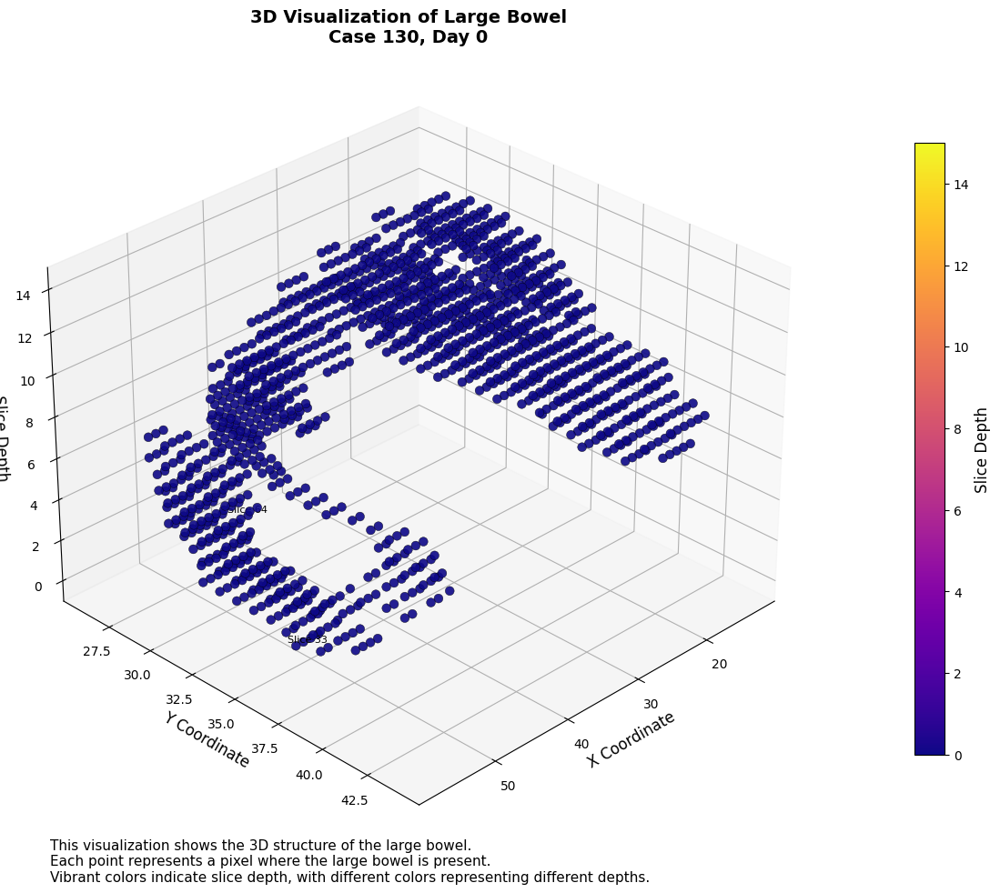

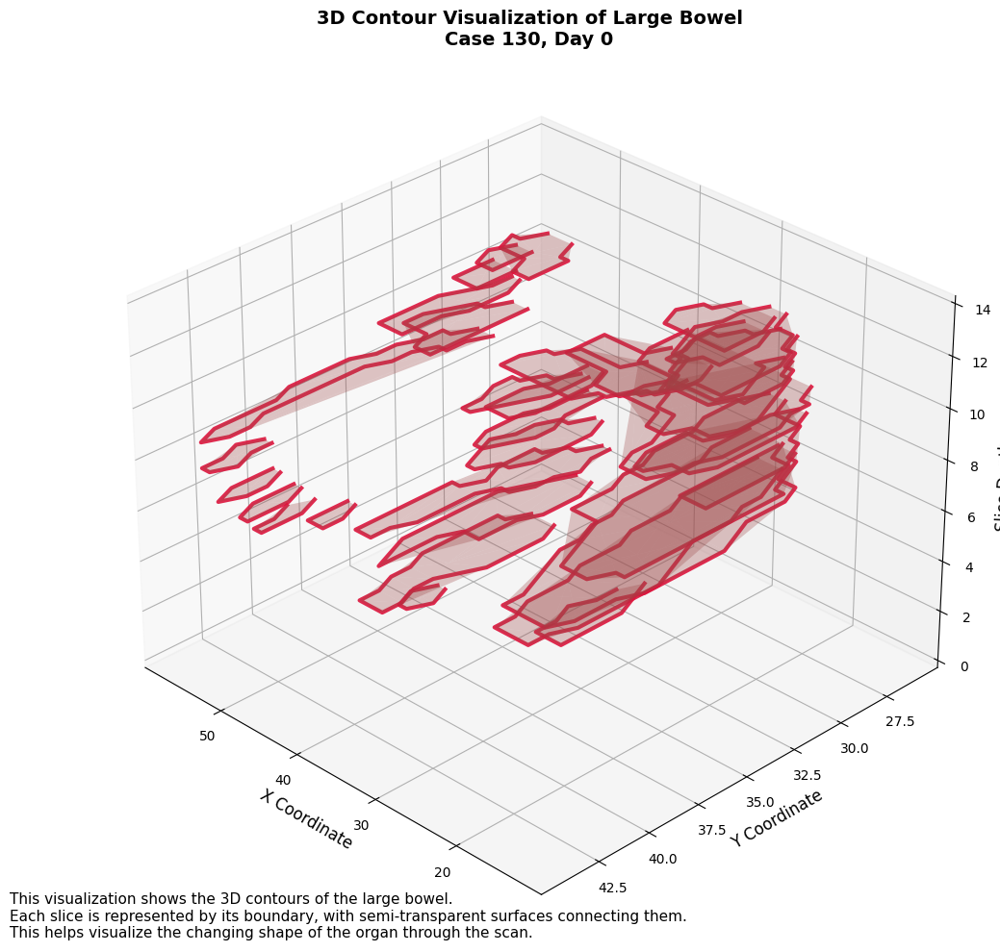

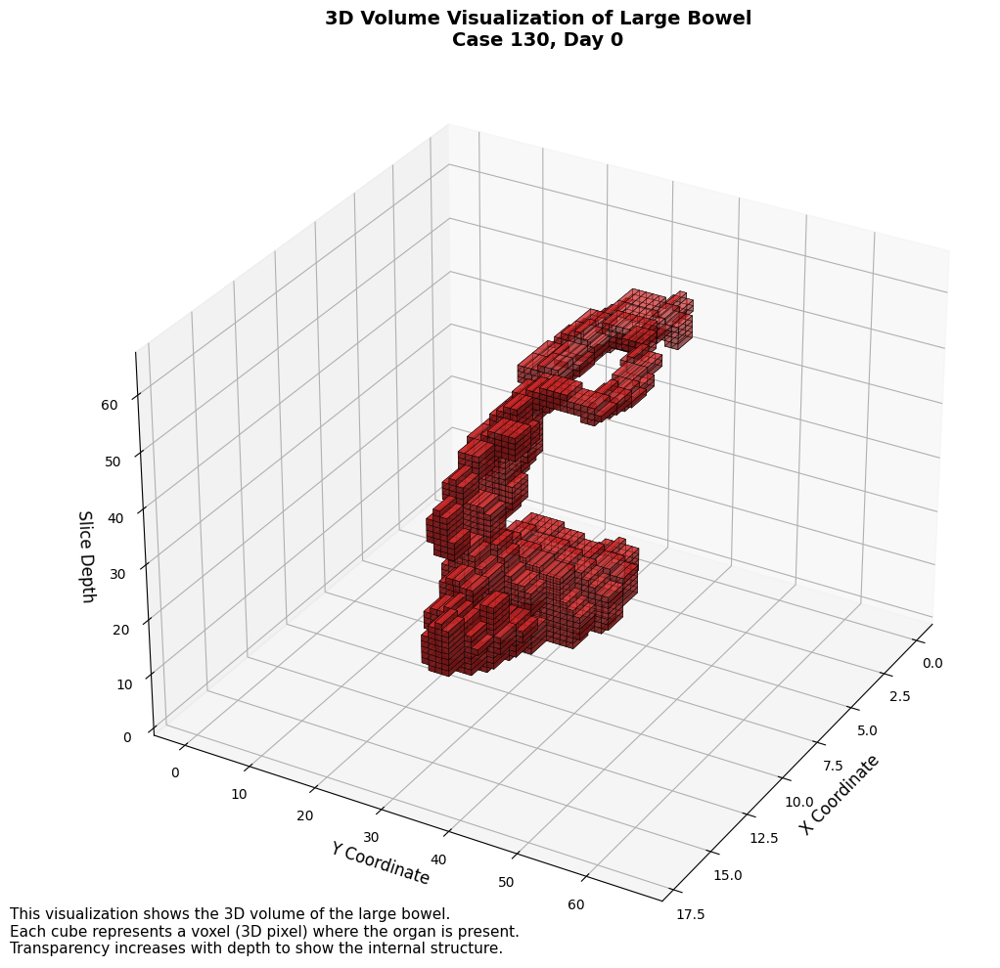


Creating 3D visualization for large_bowel, Case 65, Day 0
Found 79 slices with large_bowel masks.


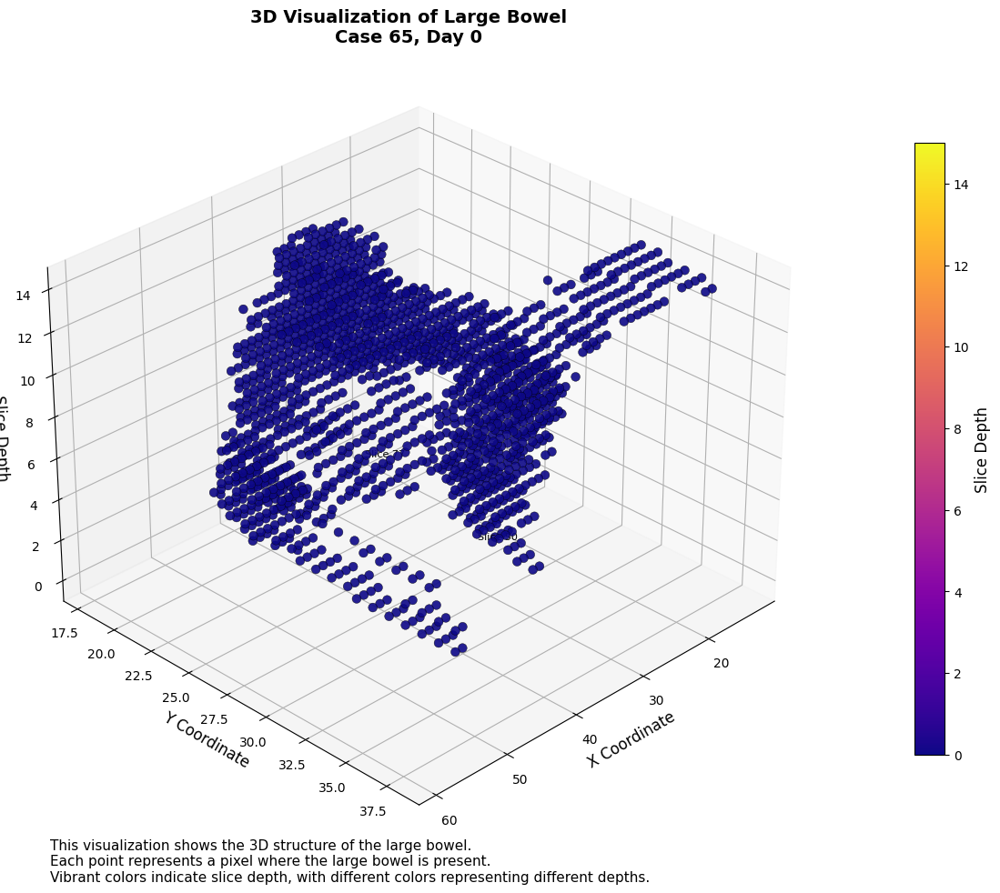

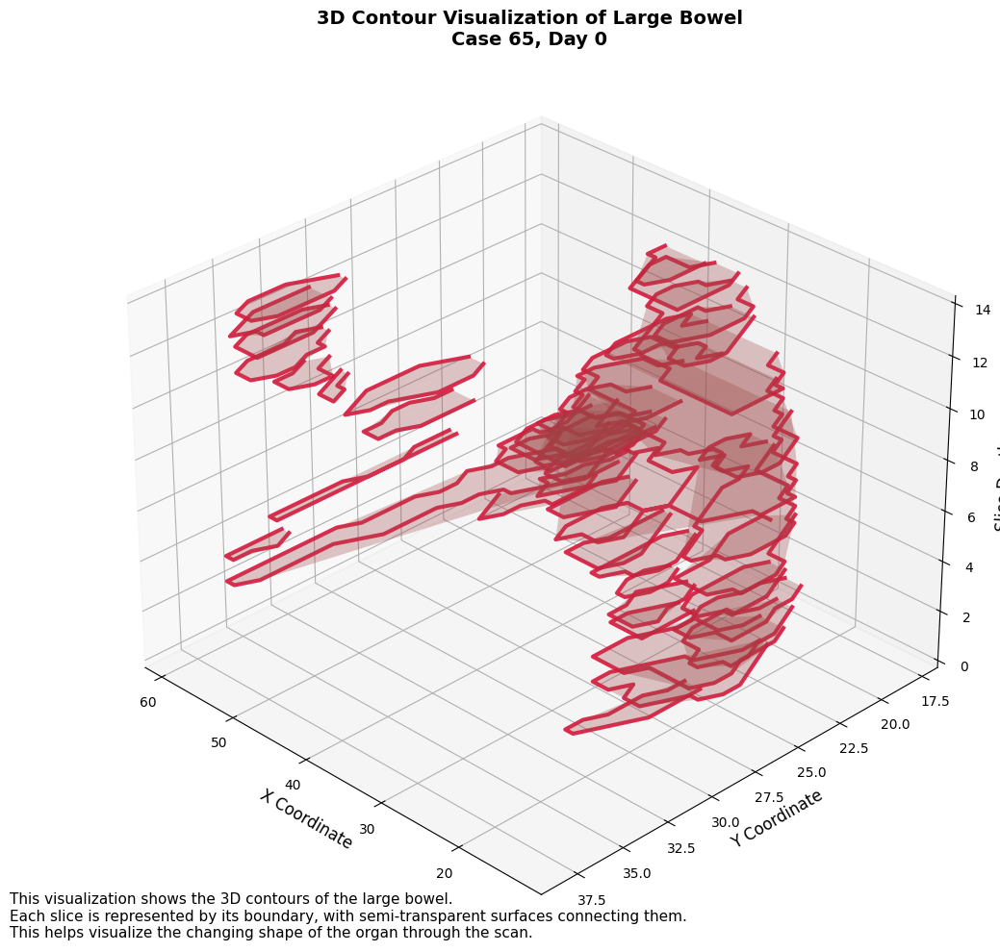

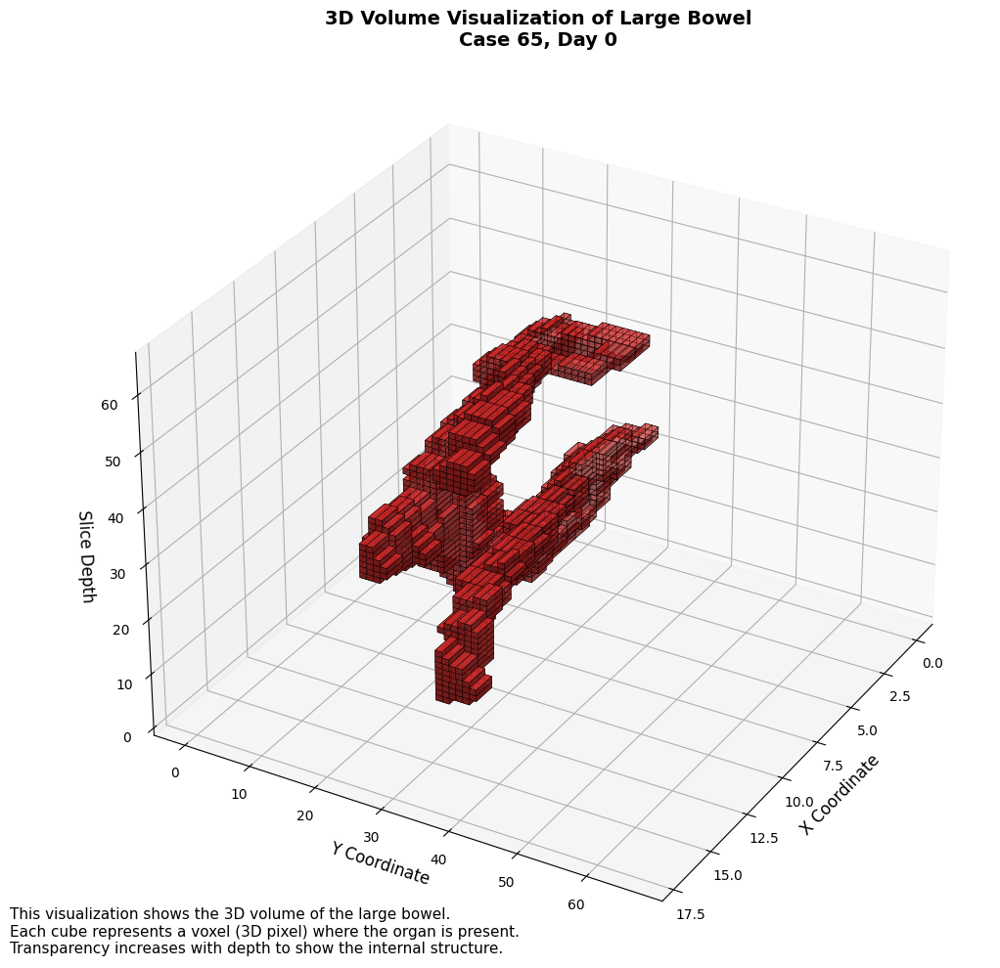


Creating 3D visualization for large_bowel, Case 54, Day 0
Found 79 slices with large_bowel masks.


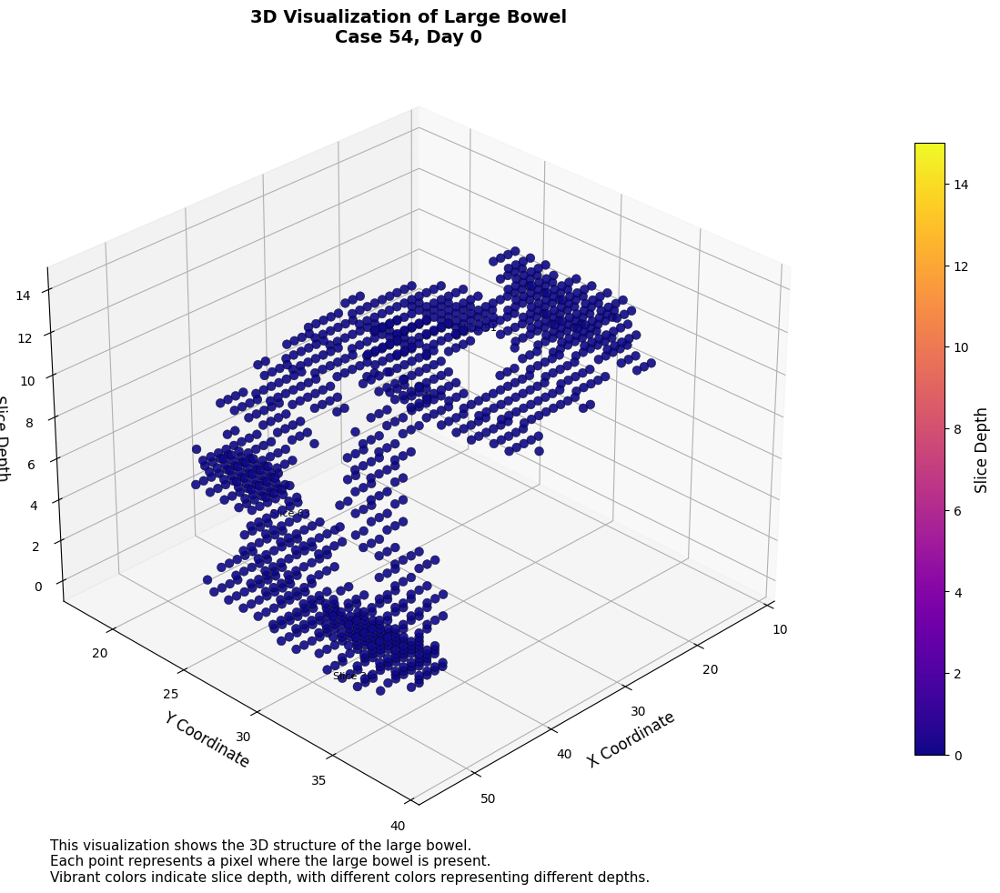

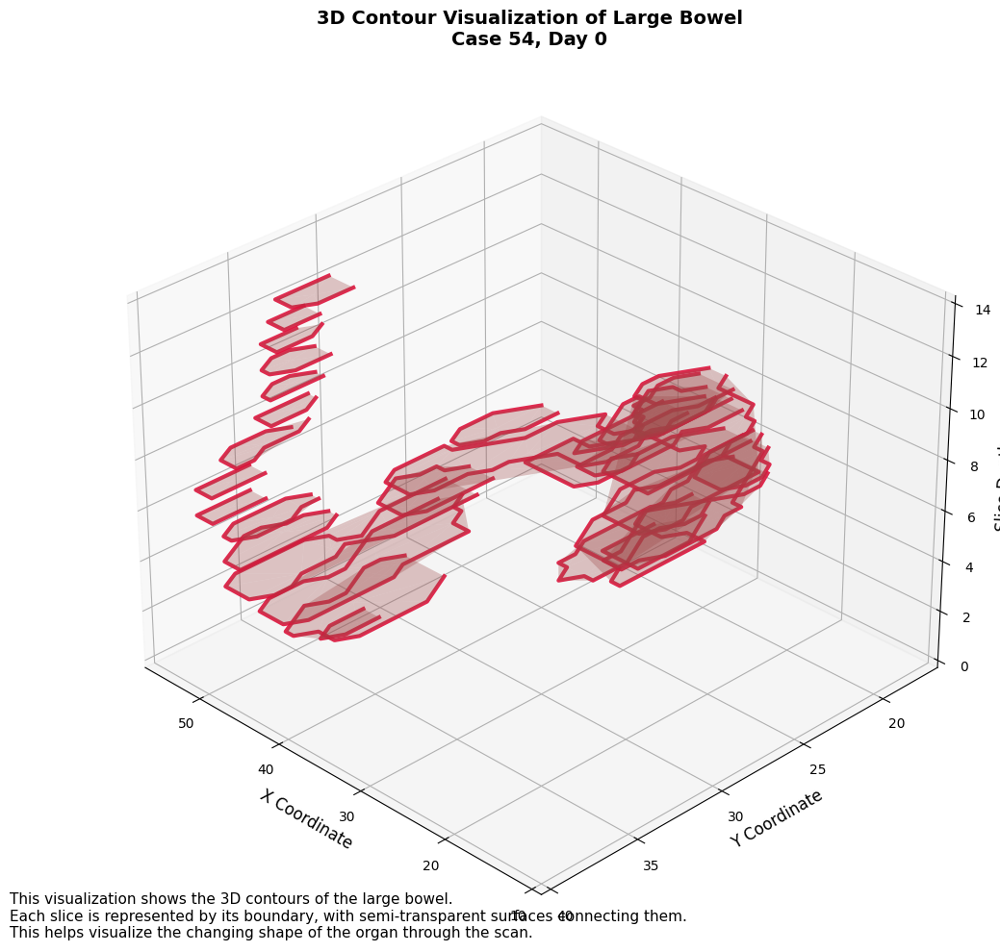

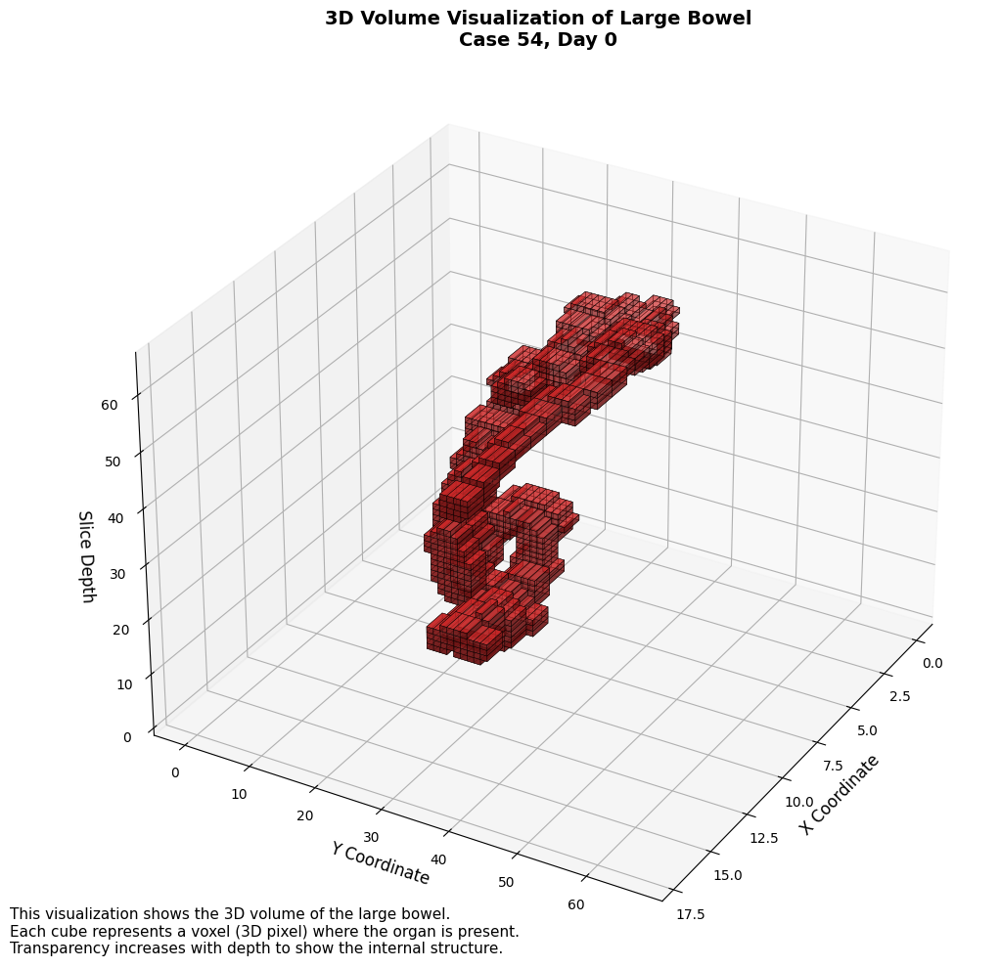


Creating 3D visualization for small_bowel, Case 130, Day 0
Found 71 slices with small_bowel masks.


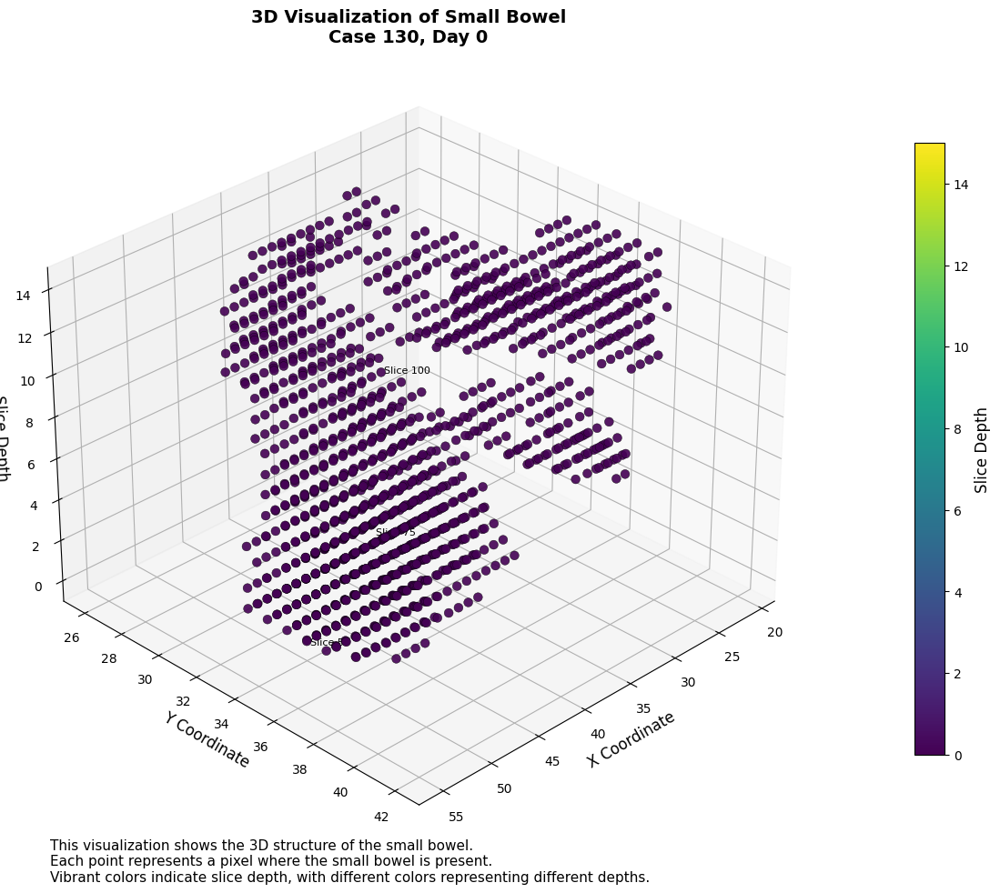

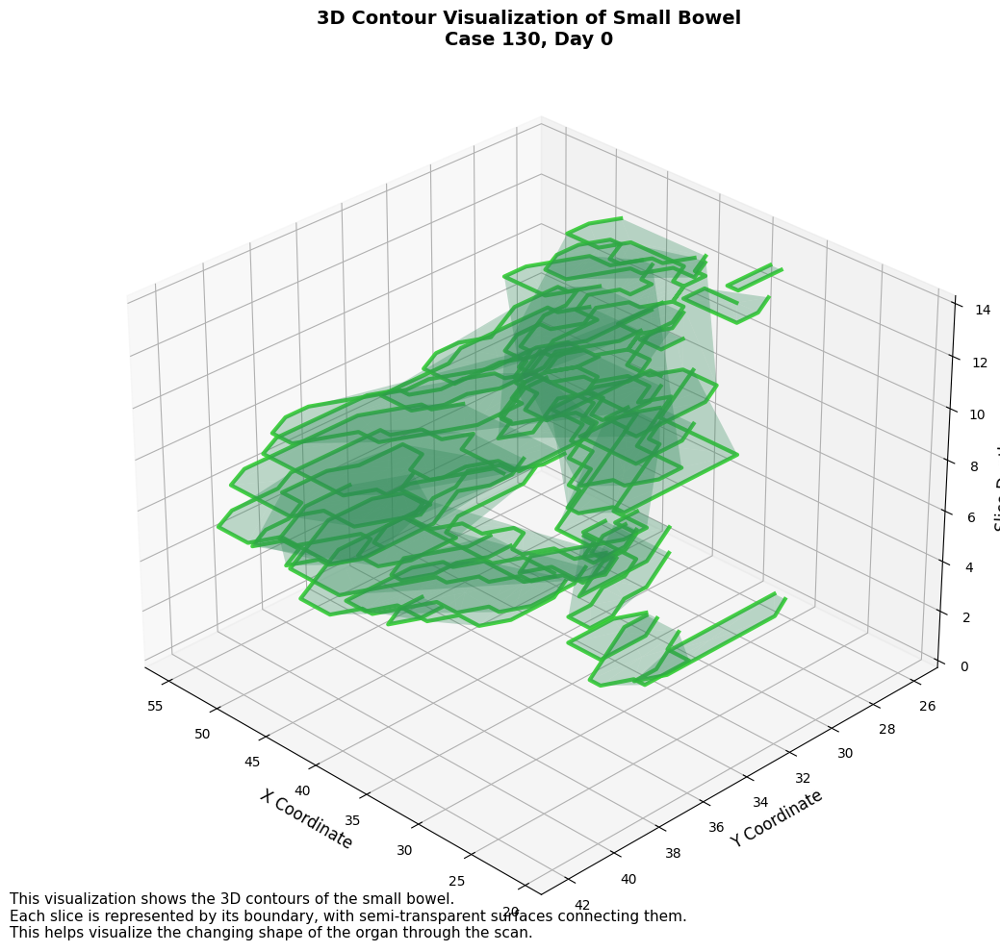

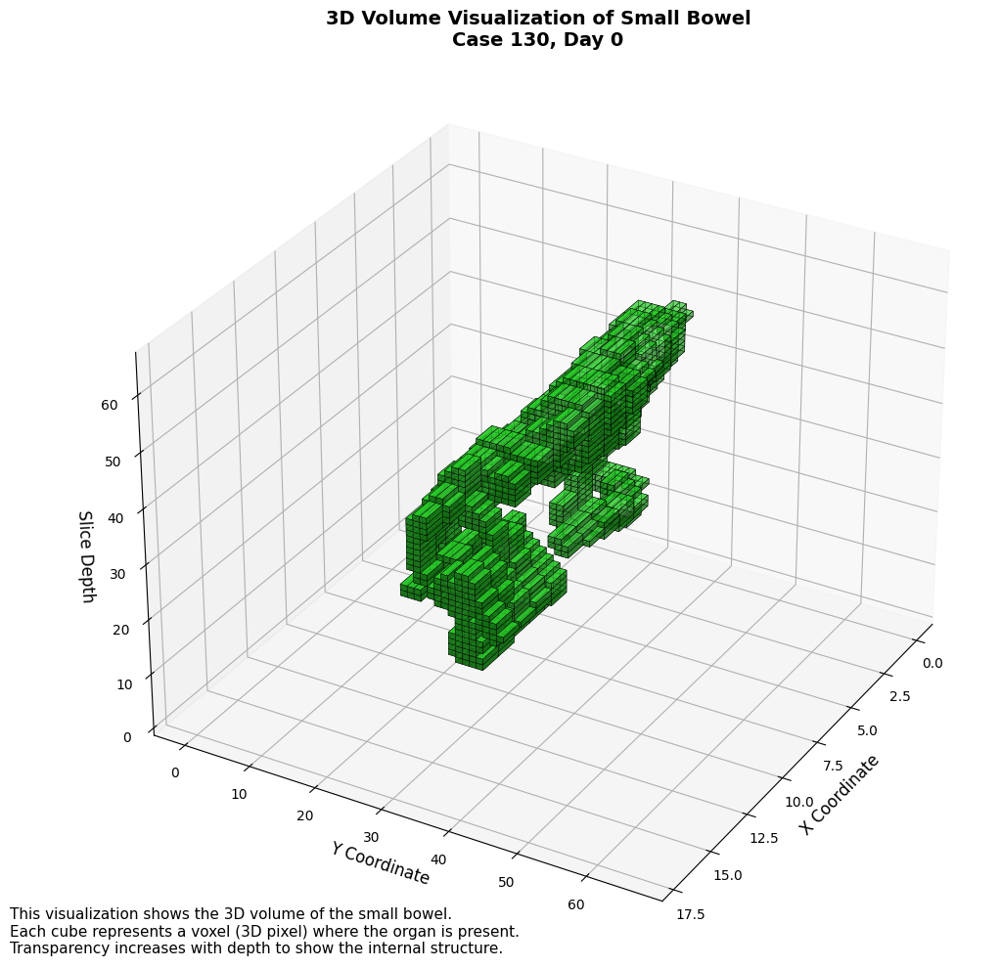


Creating 3D visualization for small_bowel, Case 36, Day 16
Found 70 slices with small_bowel masks.


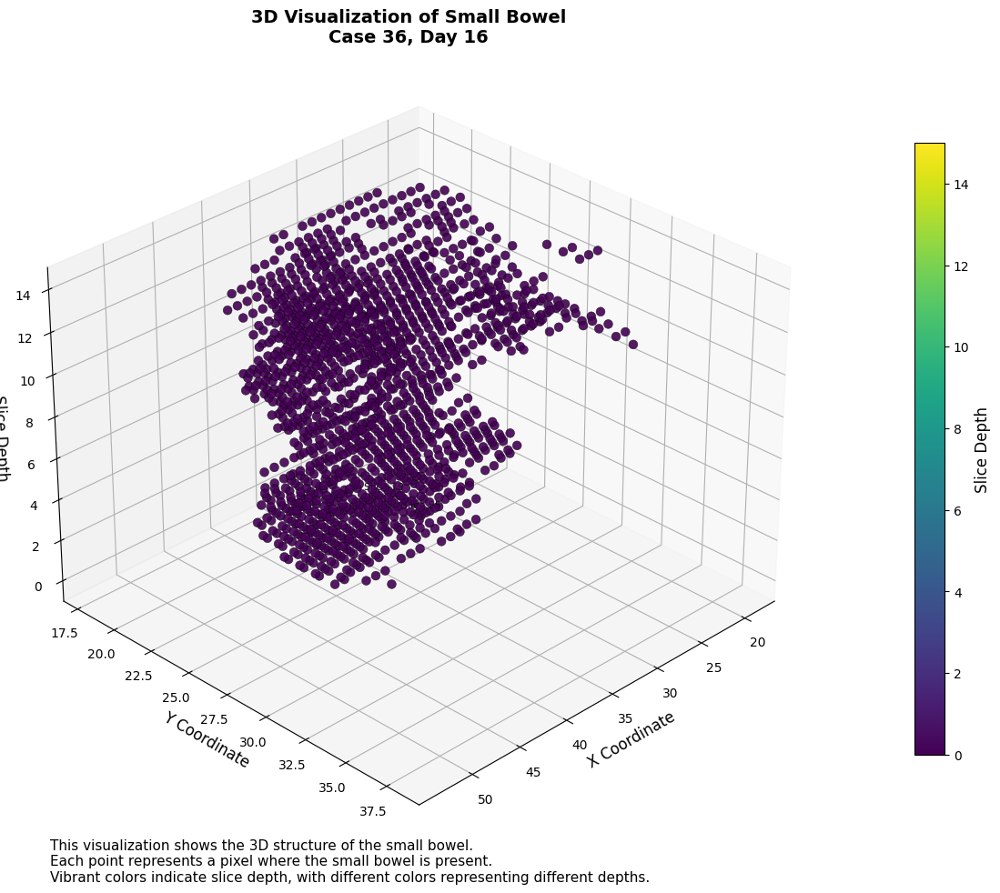

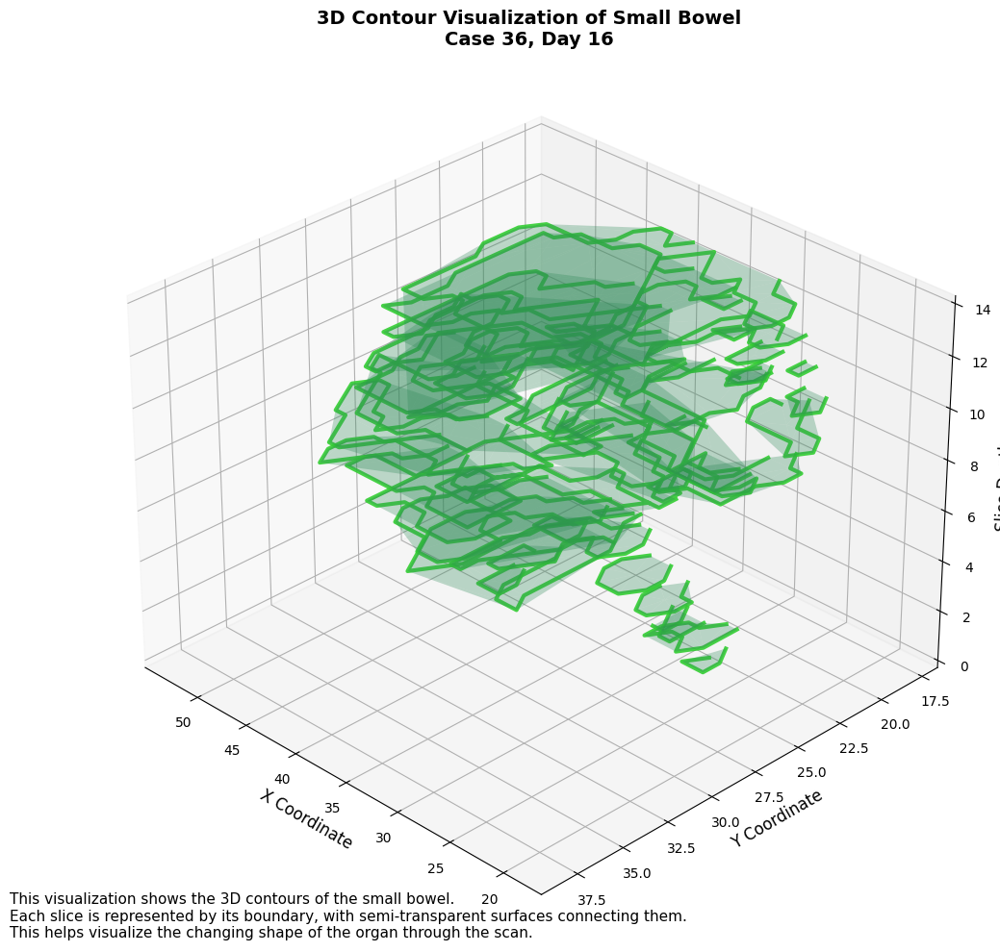

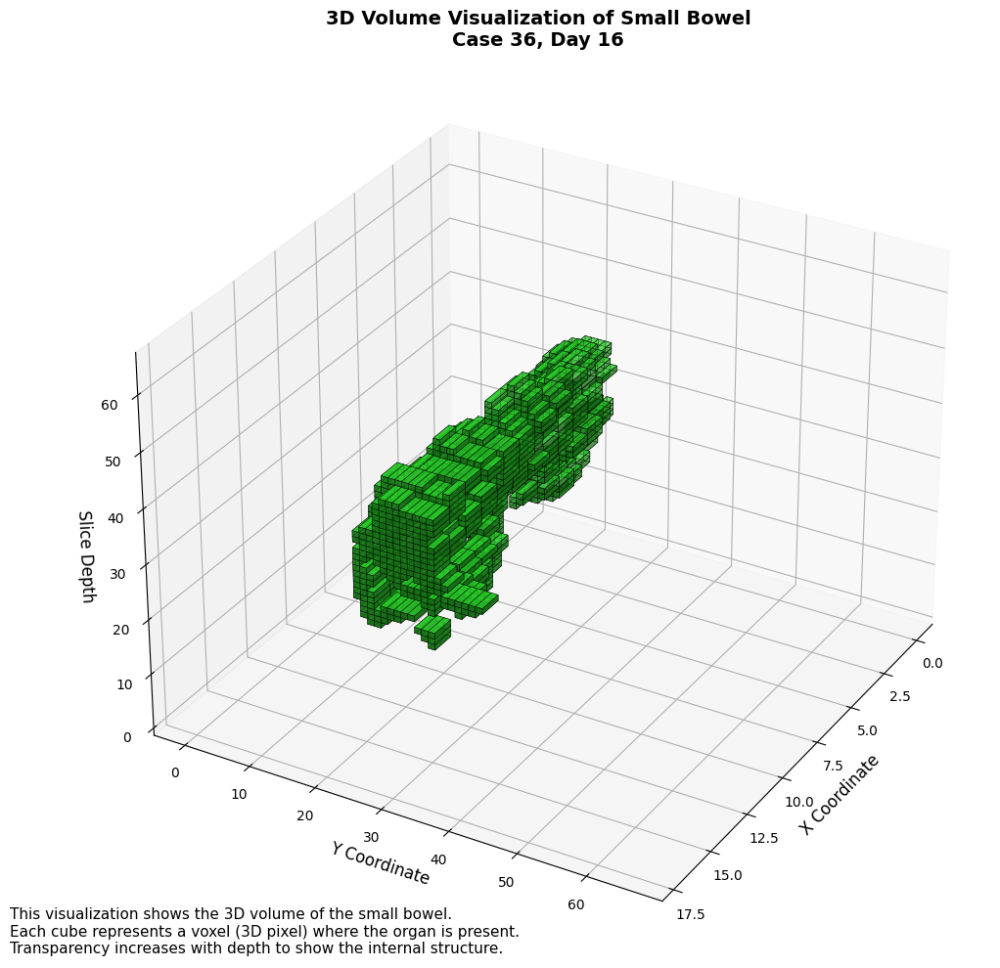


Creating 3D visualization for small_bowel, Case 134, Day 21
Found 67 slices with small_bowel masks.


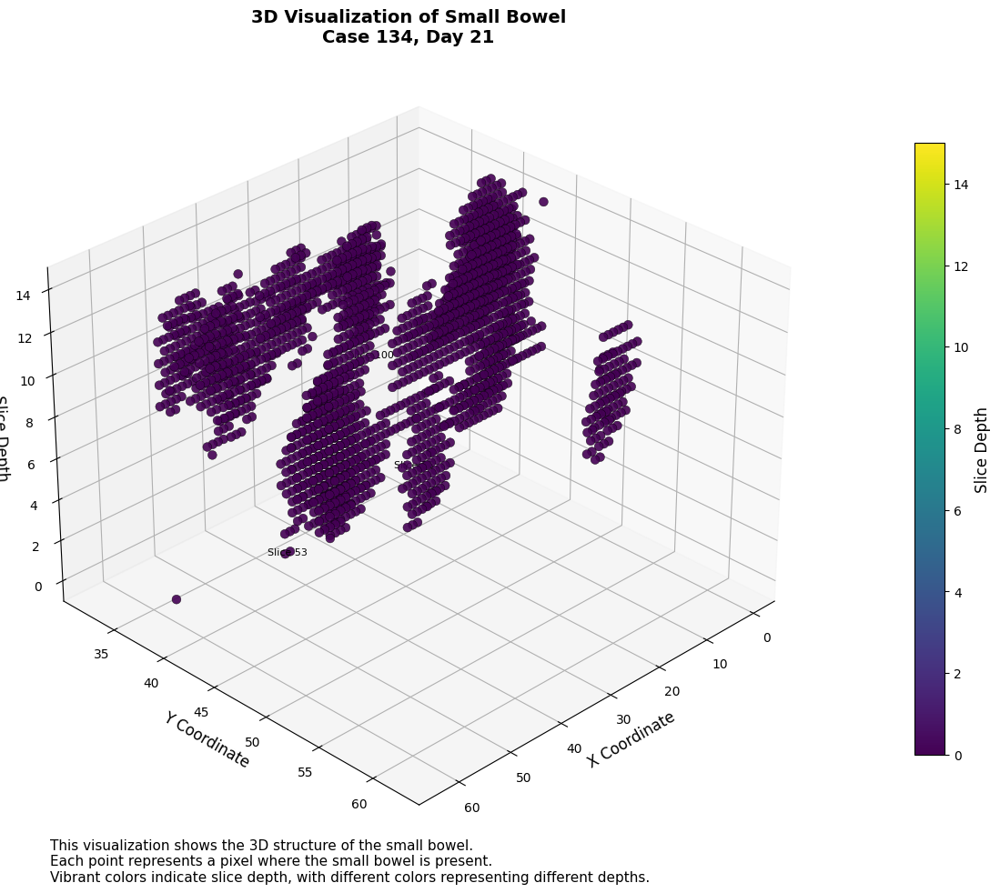

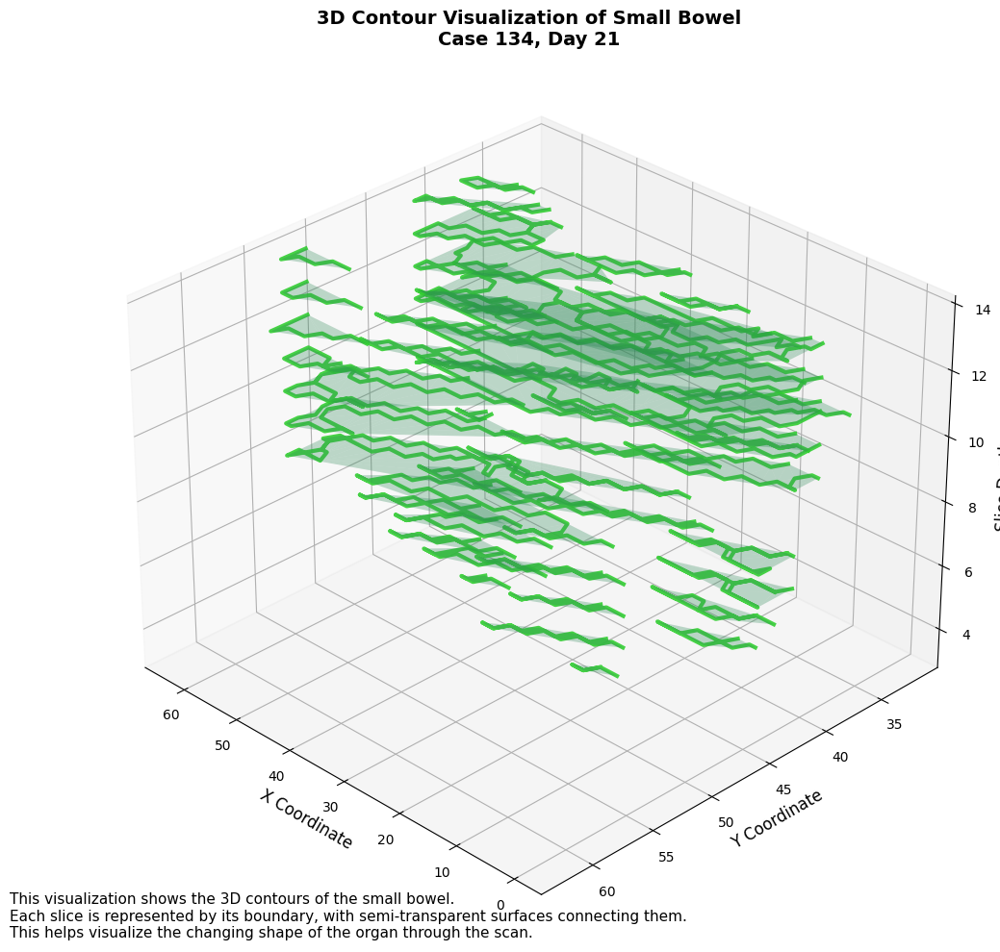

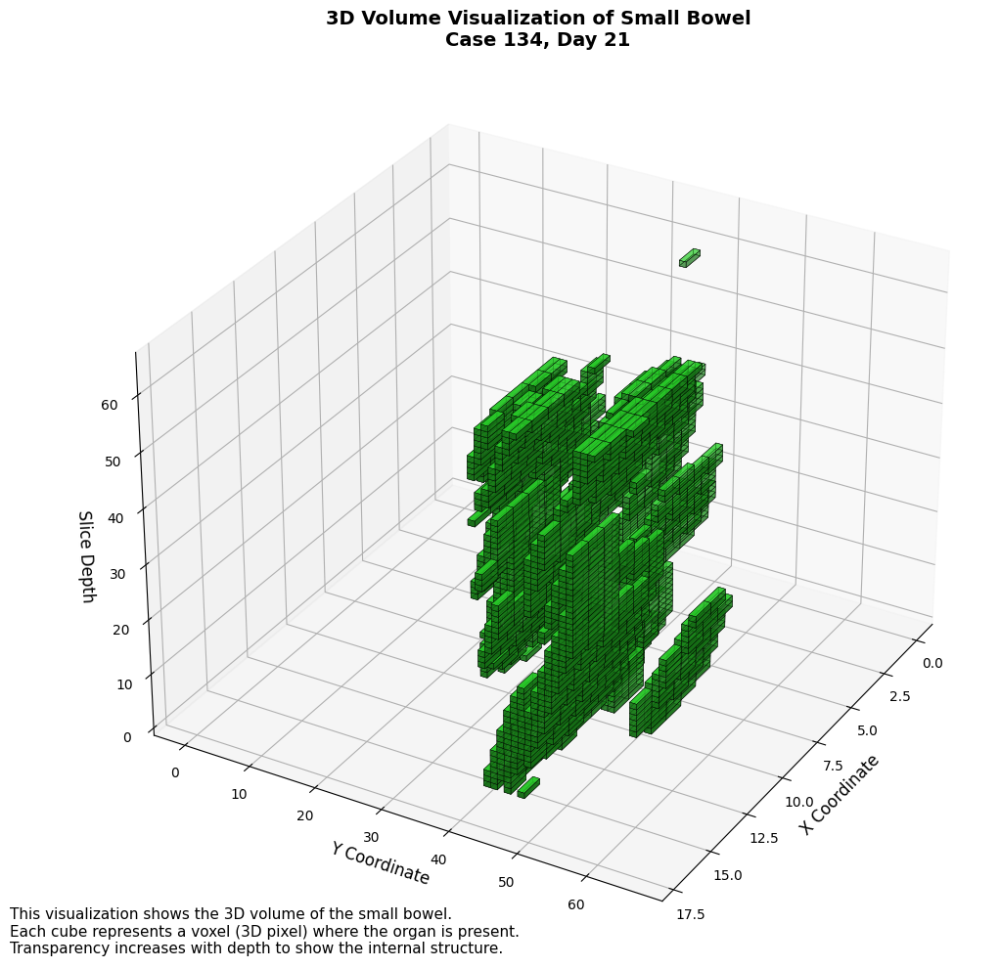


Bowel visualization completed!


In [26]:
def main_bowel_visualization():
    """Main function for 3D bowel visualization"""
    print("=" * 50)
    print("3D Bowel Structure Visualization")
    print("=" * 50)
    
    # Create 3D visualizations focusing on bowel structures
    visualize_3d_bowel()
    
    print("\nBowel visualization completed!")

if __name__ == "__main__":
    main_bowel_visualization()

# Data Preprocessing and Augmentation

In [27]:
#!pip install -q albumentations

In [28]:
import os
import gc
import random
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import albumentations as A
from sklearn.model_selection import GroupKFold
import torch
from torch.utils.data import Dataset, DataLoader
import warnings
warnings.filterwarnings("ignore")

In [29]:
DATA_DIR = '/kaggle/input/uw-madison-gi-tract-image-segmentation'
TRAIN_DIR = os.path.join(DATA_DIR, 'train')
TRAIN_CSV = os.path.join(DATA_DIR, 'train.csv')

# Global variables for data loaders
train_loader = None
val_loader = None

In [30]:
def rle_decode(rle, shape=(266, 266)):
    """
    Decode RLE encoded mask
    
    Args:
        rle: Run-length encoded mask string
        shape: Output mask shape
        
    Returns:
        Decoded mask as numpy array
    """
    if pd.isna(rle):
        return np.zeros(shape, dtype=np.uint8)
    
    # Check if the string is empty
    if not rle or rle.strip() == '':
        return np.zeros(shape, dtype=np.uint8)
    
    try:
        s = rle.split()
        starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
        starts -= 1
        ends = starts + lengths
        img = np.zeros(shape[0] * shape[1], dtype=np.uint8)
        
        for lo, hi in zip(starts, ends):
            if lo < img.shape[0] and hi <= img.shape[0]:
                img[lo:hi] = 1
        
        return img.reshape(shape)
    except Exception as e:
        print(f"Error decoding RLE: {str(e)}, RLE: {rle}")
        return np.zeros(shape, dtype=np.uint8)


In [31]:
def rle_encode(img):
    """
    Encode mask as RLE
    
    Args:
        img: Binary mask as numpy array
        
    Returns:
        RLE encoded string
    """
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    
    return ' '.join(str(x) for x in runs)

In [32]:
def load_image(path):
    """
    Load 16-bit grayscale image and normalize
    
    Args:
        path: Path to image file
        
    Returns:
        Normalized image as numpy array
    """
    try:
        # Load 16-bit image
        img = cv2.imread(path, cv2.IMREAD_UNCHANGED)
        
        if img is None:
            print(f"Warning: Failed to load image {path}")
            return np.zeros((266, 266), dtype=np.float32)
        
        # Clip and normalize to [0, 1]
        min_val = np.percentile(img, 1)
        max_val = np.percentile(img, 99)
        img = np.clip(img, min_val, max_val)
        img = ((img - min_val) / (max_val - min_val)).astype(np.float32)
        
        return img
    except Exception as e:
        print(f"Error loading image {path}: {str(e)}")
        return np.zeros((266, 266), dtype=np.float32)


In [33]:
def prepare_data(df):
    """
    Prepare and organize the dataset for training
    
    Args:
        df: DataFrame containing the dataset
        
    Returns:
        Processed DataFrame with grouped mask information
    """
    # If necessary columns don't exist, extract them from id
    if 'case' not in df.columns or 'day' not in df.columns or 'slice' not in df.columns:
        df[['case', 'day', 'slice']] = df['id'].str.extract(r'case(\d+)_day(\d+)_slice_(\d+)')
        df['case'] = df['case'].astype(int)
        df['day'] = df['day'].astype(int)
        df['slice'] = df['slice'].astype(int)
    
    # Group by case, day, slice and aggregate masks for each class
    # Fixed: using a list instead of a tuple for column selection
    grouped_df = df.groupby(['case', 'day', 'slice'])[['class', 'segmentation']].apply(
        lambda x: x.set_index('class')['segmentation'].to_dict()
    ).reset_index()
    
    grouped_df.columns = ['case', 'day', 'slice', 'masks']
    
    # Add image paths
    grouped_df['image_path'] = grouped_df.apply(
        lambda row: f"{TRAIN_DIR}/case{row['case']}/case{row['case']}_day{row['day']}/scans/slice_{row['slice']:04d}_266_266_1.50_1.50.png",
        axis=1
    )
    
    # Add case_day for grouping in cross-validation
    grouped_df['case_day'] = grouped_df['case'].astype(str) + '_' + grouped_df['day'].astype(str)
    
    # Verify image paths exist
    grouped_df['exists'] = grouped_df['image_path'].apply(os.path.exists)
    if not grouped_df['exists'].all():
        print(f"Warning: {(~grouped_df['exists']).sum()} image paths do not exist!")
        grouped_df = grouped_df[grouped_df['exists']].reset_index(drop=True)
    
    # Remove the 'exists' column to save memory
    grouped_df = grouped_df.drop(columns=['exists'])
    
    # Run garbage collection
    gc.collect()
    
    return grouped_df


In [34]:
def create_folds(df, n_splits=5):
    """
    Create cross-validation folds based on case_day groups
    
    Args:
        df: Processed DataFrame
        n_splits: Number of folds
        
    Returns:
        DataFrame with fold column added
    """
    # Create group k-fold based on case_day
    gkf = GroupKFold(n_splits=n_splits)
    
    # Add fold column
    df['fold'] = -1
    
    # Assign folds
    for fold, (_, val_idx) in enumerate(gkf.split(df, groups=df['case_day'])):
        df.loc[val_idx, 'fold'] = fold
    
    # Run garbage collection
    gc.collect()
    
    return df

In [35]:
class GITractDataset(Dataset):
    """
    Dataset class for GI Tract Image Segmentation
    """
    def __init__(self, df, transforms=None, test=False):
        """
        Initialize dataset
        
        Args:
            df: DataFrame with dataset information
            transforms: Albumentations transformations
            test: Whether this is a test dataset
        """
        self.df = df
        self.transforms = transforms
        self.test = test
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx):
        """Get dataset item"""
        row = self.df.iloc[idx]
        
        # Load image
        image_path = row['image_path']
        image = load_image(image_path)
        
        # Create mask: channels are [large_bowel, small_bowel, stomach]
        mask = np.zeros((266, 266, 3), dtype=np.float32)
        
        if not self.test:
            if 'large_bowel' in row['masks'] and not pd.isna(row['masks'].get('large_bowel')):
                mask[:, :, 0] = rle_decode(row['masks']['large_bowel'])
            if 'small_bowel' in row['masks'] and not pd.isna(row['masks'].get('small_bowel')):
                mask[:, :, 1] = rle_decode(row['masks']['small_bowel'])
            if 'stomach' in row['masks'] and not pd.isna(row['masks'].get('stomach')):
                mask[:, :, 2] = rle_decode(row['masks']['stomach'])
        
        # Apply transforms
        if self.transforms:
            transformed = self.transforms(image=image, mask=mask)
            image = transformed['image']
            mask = transformed['mask']
        
        # Convert to torch tensors
        image = torch.from_numpy(image).float().unsqueeze(0)  # Add channel dim for grayscale
        mask = torch.from_numpy(mask).float().permute(2, 0, 1)  # [H, W, C] -> [C, H, W]
        
        return {
            'image': image,
            'mask': mask,
            'case': row['case'],
            'day': row['day'],
            'slice': row['slice']
        }

In [36]:
def get_transforms(phase):
    """
    Get augmentation transforms
    
    Args:
        phase: 'train' or 'valid'
        
    Returns:
        Albumentations transforms
    """
    if phase == 'train':
        return A.Compose([
            A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.5),
            A.RandomRotate90(p=0.5),
            A.ShiftScaleRotate(
                shift_limit=0.0625, 
                scale_limit=0.1, 
                rotate_limit=15, 
                p=0.5
            ),
            A.OneOf([
                A.GridDistortion(num_steps=5, distort_limit=0.05, p=1.0),
                A.ElasticTransform(alpha=1, sigma=50, alpha_affine=50, p=1.0)
            ], p=0.25),
            A.OneOf([
                A.GaussNoise(var_limit=(10.0, 50.0), p=1.0),
                A.GaussianBlur(blur_limit=3, p=1.0),
                A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
            ], p=0.5),
        ], p=1.0)
    else:
        return A.Compose([
            # No augmentation for validation phase
        ], p=1.0)


In [37]:
def create_data_loaders(df, fold=0, batch_size=16):
    """
    Create training and validation data loaders
    
    Args:
        df: DataFrame with dataset information
        fold: Validation fold
        batch_size: Batch size
        
    Returns:
        train_loader, val_loader
    """
    global train_loader, val_loader
    
    # Create train/validation split
    train_df = df[df['fold'] != fold].reset_index(drop=True)
    val_df = df[df['fold'] == fold].reset_index(drop=True)
    
    # Create datasets
    train_dataset = GITractDataset(train_df, transforms=get_transforms('train'))
    val_dataset = GITractDataset(val_df, transforms=get_transforms('valid'))
    
    # Create data loaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory=True,
        drop_last=False
    )
    
    val_loader = DataLoader(
        val_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2,
        pin_memory=True,
        drop_last=False
    )
    
    print(f"Train loader: {len(train_loader)} batches, {len(train_dataset)} samples")
    print(f"Val loader: {len(val_loader)} batches, {len(val_dataset)} samples")
    
    return train_loader, val_loader

In [38]:
def visualize_processed_data(df, n_samples=10):
    """
    Visualize processed images and their masks
    
    Args:
        df: Processed DataFrame
        n_samples: Number of samples to visualize
    """
    # Select random samples
    random.seed(42)
    sample_indices = random.sample(range(len(df)), min(n_samples, len(df)))
    
    # Create dataset with validation transforms
    dataset = GITractDataset(df.iloc[sample_indices], transforms=get_transforms('valid'))
    
    # Create figure
    fig, axes = plt.subplots(n_samples, 4, figsize=(20, 5*n_samples))
    
    # Class names for display
    class_names = ['large_bowel', 'small_bowel', 'stomach']
    
    for i in range(n_samples):
        data = dataset[i]
        
        # Extract data
        image = data['image'].squeeze().numpy()
        masks = data['mask'].numpy()
        
        # Display original image
        axes[i, 0].imshow(image, cmap='gray')
        axes[i, 0].set_title(f"Case {data['case']}, Day {data['day']}, Slice {data['slice']}")
        axes[i, 0].axis('off')
        
        # Display individual masks
        for j in range(3):
            axes[i, j+1].imshow(masks[j], cmap='viridis')
            axes[i, j+1].set_title(f"{class_names[j]} Mask")
            axes[i, j+1].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Display augmented training examples
    train_transforms = get_transforms('train')
    
    fig, axes = plt.subplots(5, 4, figsize=(20, 25))
    
    # Select one sample for augmentation examples
    sample_idx = sample_indices[0]
    sample_row = df.iloc[sample_idx]
    
    # Load original image and mask
    image = load_image(sample_row['image_path'])
    
    mask = np.zeros((266, 266, 3), dtype=np.float32)
    if 'large_bowel' in sample_row['masks'] and not pd.isna(sample_row['masks'].get('large_bowel')):
        mask[:, :, 0] = rle_decode(sample_row['masks']['large_bowel'])
    if 'small_bowel' in sample_row['masks'] and not pd.isna(sample_row['masks'].get('small_bowel')):
        mask[:, :, 1] = rle_decode(sample_row['masks']['small_bowel'])
    if 'stomach' in sample_row['masks'] and not pd.isna(sample_row['masks'].get('stomach')):
        mask[:, :, 2] = rle_decode(sample_row['masks']['stomach'])
    
    # Original image and combined mask
    axes[0, 0].imshow(image, cmap='gray')
    axes[0, 0].set_title("Original Image")
    axes[0, 0].axis('off')
    
    combined_mask = np.zeros((266, 266, 3), dtype=np.float32)
    combined_mask[:, :, 0] = mask[:, :, 0]  # Red for large bowel
    combined_mask[:, :, 1] = mask[:, :, 1]  # Green for small bowel
    combined_mask[:, :, 2] = mask[:, :, 2]  # Blue for stomach
    
    axes[0, 1].imshow(combined_mask)
    axes[0, 1].set_title("Original Combined Mask")
    axes[0, 1].axis('off')
    
    # Apply different augmentations
    for i in range(1, 5):
        augmented = train_transforms(image=image, mask=mask)
        aug_image = augmented['image']
        aug_mask = augmented['mask']
        
        axes[i, 0].imshow(aug_image, cmap='gray')
        axes[i, 0].set_title(f"Augmented Image {i}")
        axes[i, 0].axis('off')
        
        # Display individual augmented masks
        for j in range(3):
            axes[i, j+1].imshow(aug_mask[:, :, j], cmap='viridis')
            axes[i, j+1].set_title(f"Augmented {class_names[j]} Mask")
            axes[i, j+1].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Free up memory
    plt.close('all')
    gc.collect()


Data Preprocessing for GI Tract Image Segmentation
Loading data...
Loaded data with 115488 rows

Preparing data...
Processed data with 25920 rows

Creating cross-validation folds...

Fold distribution:
Fold 0: 5184 samples
Fold 1: 5184 samples
Fold 2: 5184 samples
Fold 3: 5184 samples
Fold 4: 5184 samples

Class distribution:
large_bowel: 9177 samples (35.41%)
small_bowel: 7355 samples (28.38%)
stomach: 5796 samples (22.36%)

Visualizing processed data:


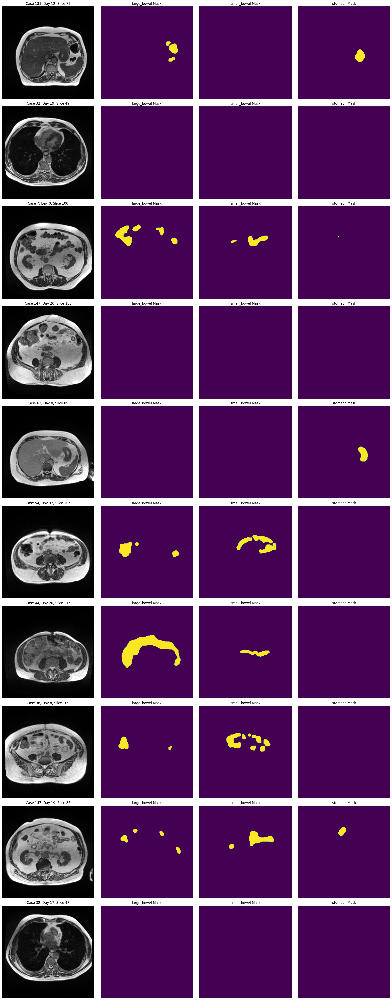

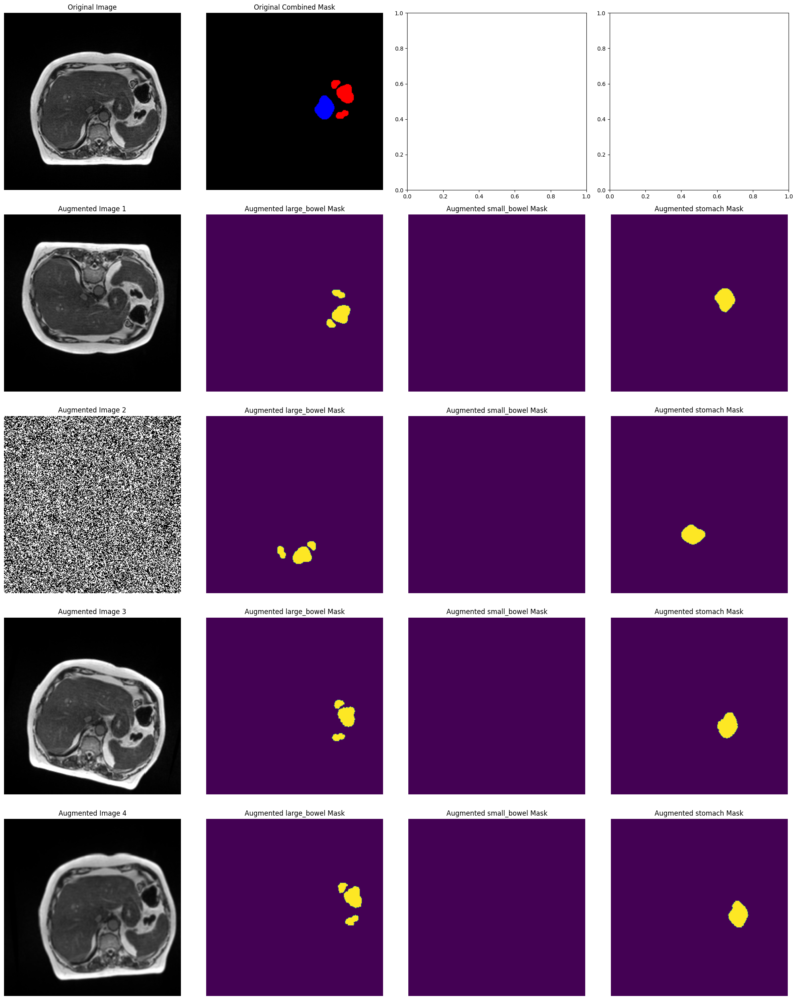


Creating data loaders for fold 0:
Train loader: 1296 batches, 20736 samples
Val loader: 324 batches, 5184 samples

Data preprocessing completed!

Memory usage information:
Current memory usage: 735.73 MB

Dataset and loaders are ready for model training.


In [39]:
def main_preprocessing():
    """Main function for data preprocessing"""
    print("=" * 50)
    print("Data Preprocessing for GI Tract Image Segmentation")
    print("=" * 50)
    
    # Load data
    print("Loading data...")
    df = pd.read_csv(TRAIN_CSV)
    print(f"Loaded data with {len(df)} rows")
    
    # Extract case, day, and slice from the id column
    # Format: case{case}_day{day}_slice_{slice}
    if 'id' in df.columns:
        df[['case', 'day', 'slice']] = df['id'].str.extract(r'case(\d+)_day(\d+)_slice_(\d+)')
        df['case'] = df['case'].astype(int)
        df['day'] = df['day'].astype(int)
        df['slice'] = df['slice'].astype(int)
    
    # Free up memory
    gc.collect()
    
    # Prepare data
    print("\nPreparing data...")
    processed_df = prepare_data(df)
    print(f"Processed data with {len(processed_df)} rows")
    
    # Free up memory - we don't need the original dataframe anymore
    del df
    gc.collect()
    
    # Create folds
    print("\nCreating cross-validation folds...")
    folded_df = create_folds(processed_df, n_splits=5)
    
    # Free up memory - processed_df is now replaced by folded_df
    del processed_df
    gc.collect()
    
    # Print fold distribution
    fold_counts = folded_df['fold'].value_counts().sort_index()
    print("\nFold distribution:")
    for fold, count in fold_counts.items():
        print(f"Fold {fold}: {count} samples")
    
    # Count distribution of classes
    class_counts = {
        'large_bowel': sum('large_bowel' in masks and not pd.isna(masks.get('large_bowel', np.nan)) 
                          for masks in folded_df['masks']),
        'small_bowel': sum('small_bowel' in masks and not pd.isna(masks.get('small_bowel', np.nan)) 
                          for masks in folded_df['masks']),
        'stomach': sum('stomach' in masks and not pd.isna(masks.get('stomach', np.nan)) 
                      for masks in folded_df['masks'])
    }
    
    print("\nClass distribution:")
    for cls, count in class_counts.items():
        print(f"{cls}: {count} samples ({count/len(folded_df)*100:.2f}%)")
    
    # Visualize processed data
    print("\nVisualizing processed data:")
    visualize_processed_data(folded_df, n_samples=10)
    
    # Create data loaders for fold 0
    print("\nCreating data loaders for fold 0:")
    train_loader, val_loader = create_data_loaders(folded_df, fold=0, batch_size=16)
    
    print("\nData preprocessing completed!")
    
    # Additional memory usage information
    print("\nMemory usage information:")
    import psutil
    process = psutil.Process(os.getpid())
    print(f"Current memory usage: {process.memory_info().rss / (1024 * 1024):.2f} MB")
    
    # Return the dataset ready for training, but only if needed
    return folded_df, train_loader, val_loader

if __name__ == "__main__":
    # Only create the full dataset when running this script directly
    folded_df, train_loader, val_loader = main_preprocessing()
    
    # Keep the data loaders and folded_df for the model training
    print("\nDataset and loaders are ready for model training.")

# Model Development and Training Pipeline

In [40]:
!pip install -q segmentation-models-pytorch

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.3/121.3 kB 6.3 MB/s eta 0:00:00


In [41]:
import gc
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models
from torch.utils.data import DataLoader
import segmentation_models_pytorch as smp
from segmentation_models_pytorch.losses import DiceLoss, LovaszLoss
import timm
import math
import sys
from tqdm.notebook import tqdm
import warnings
warnings.filterwarnings("ignore")

In [42]:
# Ensure reproducibility
torch.manual_seed(42)
np.random.seed(42)

In [43]:
print(f"CUDA available: {torch.cuda.is_available()}")
print(f"GPU count: {torch.cuda.device_count()}")
if torch.cuda.is_available():
    print(f"GPU name: {torch.cuda.get_device_name(0)}")

CUDA available: True
GPU count: 1
GPU name: Tesla P100-PCIE-16GB


In [44]:
class UNetWithResNetBackbone(nn.Module):
    """
    UNet architecture with ResNet backbone for image segmentation.
    Includes padding to handle dimensions not divisible by 32.
    """
    
    def __init__(self, backbone='resnet34', num_classes=3, pretrained=True):
        """
        Initialize the model
        
        Args:
            backbone: ResNet variant to use ('resnet18', 'resnet34', 'resnet50', etc.)
            num_classes: Number of output segmentation classes
            pretrained: Whether to use pretrained weights for backbone
        """
        super(UNetWithResNetBackbone, self).__init__()
        
        # Create the model using segmentation-models-pytorch for efficiency
        self.model = smp.Unet(
            encoder_name=backbone,        # backbone encoder name
            encoder_weights="imagenet" if pretrained else None,
            in_channels=1,                # input channels (1 for grayscale)
            classes=num_classes,          # number of output classes
            activation=None,              # no activation, we'll apply it in the loss function
        )
        
        # Calculate padding needed
        # UNet with ResNet backbone requires dimensions divisible by 32
        self.pad_h = (32 - 266 % 32) % 32
        self.pad_w = (32 - 266 % 32) % 32
        
        print(f"Model will use padding: h_pad={self.pad_h}, w_pad={self.pad_w}")
    
    def forward(self, x):
        """Forward pass with padding and cropping to handle dimensions"""
        batch_size, channels, height, width = x.shape
        
        # Apply padding to make dimensions divisible by 32
        # Pad with zeros evenly on both sides
        x_padded = F.pad(x, (self.pad_w//2, self.pad_w-self.pad_w//2, 
                             self.pad_h//2, self.pad_h-self.pad_h//2))
        
        # Pass through model
        output_padded = self.model(x_padded)
        
        # Crop back to original dimensions
        output = output_padded[:, :, 
                               self.pad_h//2:self.pad_h//2 + height, 
                               self.pad_w//2:self.pad_w//2 + width]
        
        return output


In [45]:
class DiceCoefficient(nn.Module):
    """
    Dice coefficient for segmentation evaluation.
    Formula: 2 * |X ∩ Y| / (|X| + |Y|)
    Where X and Y are the predicted and ground truth masks.
    """
    
    def __init__(self, smooth=1.0):
        super(DiceCoefficient, self).__init__()
        self.smooth = smooth
        
    def forward(self, y_pred, y_true):
        # Flatten predicted and true masks
        y_pred = y_pred.view(-1)
        y_true = y_true.view(-1)
        
        # Calculate Dice
        intersection = (y_pred * y_true).sum()
        dice = (2.0 * intersection + self.smooth) / (y_pred.sum() + y_true.sum() + self.smooth)
        
        return dice

In [46]:
class DiceBCELoss(nn.Module):
    """
    Combined Dice and BCE loss for segmentation.
    Combines Dice loss and Binary Cross-Entropy loss for better training
    of segmentation models.
    """
    
    def __init__(self, smooth=1.0, bce_weight=0.5):
        super(DiceBCELoss, self).__init__()
        self.dice = DiceLoss(mode='binary', smooth=smooth)
        self.bce = nn.BCEWithLogitsLoss()
        self.bce_weight = bce_weight
        
    def forward(self, y_pred, y_true):
        # Calculate losses for each class separately
        total_loss = 0
        dice_scores = []
        
        # Handle multi-class segmentation by processing each channel
        for i in range(y_pred.shape[1]):
            # Get the i-th channel for predicted and true
            pred_channel = y_pred[:, i, :, :]
            true_channel = y_true[:, i, :, :]
            
            # Calculate Dice loss for this channel
            dice_loss = self.dice(pred_channel, true_channel)
            
            # Calculate BCE loss for this channel
            bce_loss = self.bce(pred_channel, true_channel)
            
            # Combine losses
            channel_loss = dice_loss + self.bce_weight * bce_loss
            
            # Add to total loss
            total_loss += channel_loss
            
            # Store dice score (1 - dice_loss) for monitoring
            dice_scores.append(1.0 - dice_loss.item())
        
        # Average over all classes
        return total_loss / y_pred.shape[1], dice_scores

In [47]:
def create_model(backbone='resnet34', num_classes=3, pretrained=True):
    """
    Create a UNet model with ResNet backbone
    
    Args:
        backbone: ResNet variant to use
        num_classes: Number of output segmentation classes
        pretrained: Whether to use pretrained weights
        
    Returns:
        model: The initialized model
    """
    model = UNetWithResNetBackbone(backbone=backbone, num_classes=num_classes, pretrained=pretrained)
    
    # Move to GPU if available
    if torch.cuda.is_available():
        model = model.cuda()
        
    return model

In [48]:
def get_optimizer_and_scheduler(model, lr=3e-4, weight_decay=1e-6, epochs=30):
    """
    Get optimizer and learning rate scheduler
    
    Args:
        model: The model to optimize
        lr: Learning rate
        weight_decay: Weight decay for regularization
        epochs: Number of training epochs
        
    Returns:
        optimizer: The optimizer
        scheduler: The learning rate scheduler
    """
    # Initialize optimizer with different parameters for backbone and decoder
    optimizer = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)
    
    # Use cosine annealing scheduler
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
        optimizer, 
        T_max=epochs,
        eta_min=1e-6
    )
    
    return optimizer, scheduler


In [49]:
def train_one_epoch(model, train_loader, optimizer, criterion, device):
    """Train the model for one epoch with progress bar"""
    model.train()
    train_loss = 0.0
    dice_scores = []
    
    # Create a progress bar
    progress_bar = tqdm(train_loader, desc="Training", leave=True)
    
    for batch_idx, batch in enumerate(progress_bar):
        # Get data
        images = batch['image'].to(device)
        targets = batch['mask'].to(device)
        
        # Forward pass
        outputs = model(images)
        loss, batch_dice_scores = criterion(outputs, targets)
        
        # Backward pass and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # Update metrics
        train_loss += loss.item() * images.size(0)
        avg_dice = sum(batch_dice_scores) / len(batch_dice_scores)
        dice_scores.extend(batch_dice_scores)
        
        # Update progress bar description
        progress_bar.set_postfix({
            'Loss': f"{loss.item():.4f}", 
            'Dice': f"{avg_dice:.4f}"
        })
        
        # Periodic memory cleanup
        if batch_idx % 50 == 49:
            torch.cuda.empty_cache()
            gc.collect()
    
    # Calculate average metrics
    train_loss = train_loss / len(train_loader.dataset)
    train_dice = sum(dice_scores) / len(dice_scores)
    
    # Final cleanup
    torch.cuda.empty_cache()
    gc.collect()
    
    return train_loss, train_dice

In [50]:
def validate(model, val_loader, criterion, device):
    """
    Validate the model with progress bar
    
    Args:
        model: The model to validate
        val_loader: DataLoader for validation data
        criterion: Loss function
        device: Device to validate on (cuda or cpu)
        
    Returns:
        val_loss: Average validation loss
        val_dice: Average Dice coefficient on validation set
    """
    model.eval()
    val_loss = 0.0
    dice_scores = []
    
    # Create a progress bar for validation
    progress_bar = tqdm(val_loader, desc="Validating", leave=True)
    
    with torch.no_grad():
        for batch in progress_bar:
            # Get data
            images = batch['image'].to(device)
            targets = batch['mask'].to(device)
            
            # Forward pass
            outputs = model(images)
            loss, batch_dice_scores = criterion(outputs, targets)
            
            # Update metrics
            val_loss += loss.item() * images.size(0)
            avg_dice = sum(batch_dice_scores) / len(batch_dice_scores)
            dice_scores.extend(batch_dice_scores)
            
            # Update progress bar description
            progress_bar.set_postfix({
                'Loss': f"{loss.item():.4f}", 
                'Dice': f"{avg_dice:.4f}"
            })
    
    # Calculate average metrics
    val_loss = val_loss / len(val_loader.dataset)
    val_dice = sum(dice_scores) / len(dice_scores)
    
    # Clear memory
    torch.cuda.empty_cache()
    gc.collect()
    
    return val_loss, val_dice

In [51]:
def get_3d_hausdorff_distance(pred_masks, true_masks, spacing=(1.0, 1.0, 1.0)):
    """
    Calculate 3D Hausdorff distance between predicted and true 3D masks
    
    Args:
        pred_masks: Predicted masks (B, C, D, H, W) where D is the depth dimension
        true_masks: Ground truth masks (B, C, D, H, W)
        spacing: Voxel spacing in (z, y, x) order, defaults to (1.0, 1.0, 1.0)
    
    Returns:
        hausdorff_distance: Average 3D Hausdorff distance
    """
    from scipy.spatial.distance import directed_hausdorff
    
    # Validate input
    assert pred_masks.shape == true_masks.shape, "Predicted and ground truth masks must have the same shape"
    
    batch_size, num_classes, depth, height, width = pred_masks.shape
    hausdorff_distances = []
    
    for b in range(batch_size):
        for c in range(num_classes):
            # Get prediction and ground truth for current batch and class
            pred = pred_masks[b, c].cpu().numpy()
            true = true_masks[b, c].cpu().numpy()
            
            # Skip if either mask is empty
            if np.sum(pred) == 0 and np.sum(true) == 0:
                # Both empty, distance is 0
                hausdorff_distances.append(0.0)
                continue
            elif np.sum(pred) == 0 or np.sum(true) == 0:
                # One is empty, one is not - maximum distance
                hausdorff_distances.append(1.0)  # Normalized distance
                continue
            
            # Get coordinates of non-zero pixels
            pred_points = np.array(np.where(pred > 0.5)).T * spacing
            true_points = np.array(np.where(true > 0.5)).T * spacing
            
            if len(pred_points) == 0 or len(true_points) == 0:
                hausdorff_distances.append(1.0)  # Normalized distance
                continue
            
            # Calculate directed Hausdorff distances
            forward, _, _ = directed_hausdorff(pred_points, true_points)
            backward, _, _ = directed_hausdorff(true_points, pred_points)
            
            # Take maximum of both directions
            hausdorff = max(forward, backward)
            
            # Normalize to [0, 1] based on the diagonal of the volume
            volume_diagonal = np.sqrt(
                (depth * spacing[0])**2 + (height * spacing[1])**2 + (width * spacing[2])**2
            )
            normalized_hausdorff = min(hausdorff / volume_diagonal, 1.0)
            
            hausdorff_distances.append(normalized_hausdorff)
    
    # Return average Hausdorff distance
    return sum(hausdorff_distances) / len(hausdorff_distances) if hausdorff_distances else 1.0


In [52]:
def calculate_combined_metric(dice_score, hausdorff_distance, dice_weight=0.4, hausdorff_weight=0.6):
    """
    Calculate combined metric based on Dice coefficient and Hausdorff distance
    
    Args:
        dice_score: Dice coefficient (higher is better)
        hausdorff_distance: Hausdorff distance (lower is better)
        dice_weight: Weight for Dice score in combined metric
        hausdorff_weight: Weight for Hausdorff distance in combined metric
    
    Returns:
        combined_score: Combined metric
    """
    # Convert Hausdorff distance to a score (1 - distance) so higher is better
    hausdorff_score = 1.0 - hausdorff_distance
    
    # Calculate weighted combination
    combined_score = (dice_weight * dice_score) + (hausdorff_weight * hausdorff_score)
    
    return combined_score

In [53]:
def train_model(model, train_loader, val_loader, epochs=30, lr=3e-4, device='cuda'):
    """
    Train the model
    
    Args:
        model: The model to train
        train_loader: DataLoader for training data
        val_loader: DataLoader for validation data
        epochs: Number of training epochs
        lr: Learning rate
        device: Device to train on
        
    Returns:
        model: Trained model
        history: Training history
    """
    # Move model to device
    model = model.to(device)
    
    # Define loss function
    criterion = DiceBCELoss()
    
    # Define optimizer and scheduler
    optimizer, scheduler = get_optimizer_and_scheduler(model, lr=lr, epochs=epochs)
    
    # Initialize history
    history = {
        'train_loss': [],
        'train_dice': [],
        'val_loss': [],
        'val_dice': []
    }
    
    # Training loop
    best_val_dice = 0.0
    
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        
        # Train for one epoch
        train_loss, train_dice = train_one_epoch(model, train_loader, optimizer, criterion, device)
        
        # Validate
        val_loss, val_dice = validate(model, val_loader, criterion, device)
        
        # Update learning rate
        scheduler.step()
        
        # Update history
        history['train_loss'].append(train_loss)
        history['train_dice'].append(train_dice)
        history['val_loss'].append(val_loss)
        history['val_dice'].append(val_dice)
        
        # Print metrics
        print(f"Train Loss: {train_loss:.4f}, Train Dice: {train_dice:.4f}")
        print(f"Val Loss: {val_loss:.4f}, Val Dice: {val_dice:.4f}")
        
        # Save best model
        if val_dice > best_val_dice:
            best_val_dice = val_dice
            torch.save(model.state_dict(), 'best_model.pth')
            print(f"Saved new best model with Dice: {best_val_dice:.4f}")
        
        # Clear memory
        torch.cuda.empty_cache()
        gc.collect()
    
    # Load best model
    model.load_state_dict(torch.load('best_model.pth'))
    
    return model, history


In [54]:
def main_train_model(train_loader, val_loader, backbone='resnet34', epochs=15, lr=3e-4, batch_size=16):
    """
    Main function to train the model
    
    Args:
        train_loader: DataLoader for training data
        val_loader: DataLoader for validation data
        backbone: ResNet backbone to use
        epochs: Number of training epochs
        lr: Learning rate
        batch_size: Batch size
    
    Returns:
        model: Trained model
        history: Training history
    """
    print("=" * 50)
    print(f"Training UNet with {backbone} backbone")
    print("=" * 50)
    
    # Set device
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    
    # Create model
    model = create_model(backbone=backbone, num_classes=3, pretrained=True)
    print(f"Model created with {backbone} backbone")
    
    # Check if we have enough GPU memory
    if torch.cuda.is_available():
        free_memory = torch.cuda.get_device_properties(0).total_memory - torch.cuda.memory_allocated()
        free_memory_gb = free_memory / 1024**3
        print(f"Free GPU memory: {free_memory_gb:.2f} GB")
        
        # If less than 2GB available, reduce batch size
        if free_memory_gb < 2.0 and batch_size > 8:
            batch_size = 8
            print(f"Limited GPU memory. Reducing batch size to {batch_size}")
            
            # Recreate data loaders with smaller batch size
            if hasattr(train_loader, 'batch_size') and train_loader.batch_size > batch_size:
                from torch.utils.data import DataLoader
                train_dataset = train_loader.dataset
                val_dataset = val_loader.dataset
                
                train_loader = DataLoader(
                    train_dataset,
                    batch_size=batch_size,
                    shuffle=True,
                    num_workers=2,
                    pin_memory=True
                )
                
                val_loader = DataLoader(
                    val_dataset,
                    batch_size=batch_size,
                    shuffle=False,
                    num_workers=2,
                    pin_memory=True
                )
    
    # Train model
    model, history = train_model(
        model=model,
        train_loader=train_loader,
        val_loader=val_loader,
        epochs=epochs,
        lr=lr,
        device=device
    )
    
    print("Model training completed!")
    
    return model, history

In [55]:
if __name__ == "__main__":
    # Make sure the data loaders are available from the preprocessing step
    # Either import them or use the global variables
    
    try:
        # Get the data loaders from global variables
        # Note: train_loader and val_loader should be defined previously
        import sys
        
        # Try to import from the previous script
        try:
            from data_preprocessing_fixed import create_data_loaders, folded_df
            print("Successfully imported preprocessing modules")
            
            # If loaders don't exist, create them
            if 'train_loader' not in globals() or 'val_loader' not in globals() or globals()['train_loader'] is None:
                print("Creating data loaders")
                train_loader, val_loader = create_data_loaders(folded_df, fold=0, batch_size=8)
        except ImportError:
            print("Could not import from data_preprocessing_fixed")
            # Check if they're already in globals (run in the same notebook)
            if 'train_loader' not in globals() or 'val_loader' not in globals():
                raise NameError("train_loader and val_loader are not defined")
        
        # Set training parameters - reduced for Kaggle notebooks
        backbone = 'resnet34'  # Options: resnet18, resnet34, resnet50
        epochs = 20  
        lr = 3e-4
        batch_size = 8  
        
        # Train the model
        model, history = main_train_model(
            train_loader=train_loader,
            val_loader=val_loader,
            backbone=backbone,
            epochs=epochs,
            lr=lr,
            batch_size=batch_size
        )
        
        # Save the trained model
        torch.save(model.state_dict(), 'gi_tract_segmentation_model.pth')
        print("Model saved to gi_tract_segmentation_model.pth")
        
        # Free up memory
        del model
        torch.cuda.empty_cache()
        gc.collect()
        
    except NameError as e:
        print(f"Error: {e}")
        print("Make sure to run the data preprocessing script first to create the data loaders.")
    except Exception as e:
        print(f"Unexpected error: {e}")
        import traceback
        traceback.print_exc()

Could not import from data_preprocessing_fixed
Training UNet with resnet34 backbone
Using device: cuda


Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 240MB/s]


Model will use padding: h_pad=22, w_pad=22
Model created with resnet34 backbone
Free GPU memory: 15.80 GB
Epoch 1/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.6591, Train Dice: 0.3698
Val Loss: 0.1815, Val Dice: 0.8340
Saved new best model with Dice: 0.8340
Epoch 2/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.4673, Train Dice: 0.5490
Val Loss: 0.1703, Val Dice: 0.8436
Saved new best model with Dice: 0.8436
Epoch 3/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.4179, Train Dice: 0.5971
Val Loss: 0.1830, Val Dice: 0.8309
Epoch 4/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.3896, Train Dice: 0.6245
Val Loss: 0.1411, Val Dice: 0.8699
Saved new best model with Dice: 0.8699
Epoch 5/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.3718, Train Dice: 0.6416
Val Loss: 0.1431, Val Dice: 0.8701
Saved new best model with Dice: 0.8701
Epoch 6/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.3515, Train Dice: 0.6611
Val Loss: 0.1438, Val Dice: 0.8672
Epoch 7/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.3330, Train Dice: 0.6790
Val Loss: 0.1347, Val Dice: 0.8755
Saved new best model with Dice: 0.8755
Epoch 8/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.3221, Train Dice: 0.6894
Val Loss: 0.1242, Val Dice: 0.8852
Saved new best model with Dice: 0.8852
Epoch 9/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.3147, Train Dice: 0.6967
Val Loss: 0.1230, Val Dice: 0.8864
Saved new best model with Dice: 0.8864
Epoch 10/10


Training:   0%|          | 0/1296 [00:00<?, ?it/s]

Validating:   0%|          | 0/324 [00:00<?, ?it/s]

Train Loss: 0.3089, Train Dice: 0.7022
Val Loss: 0.1192, Val Dice: 0.8901
Saved new best model with Dice: 0.8901
Model training completed!
Model saved to gi_tract_segmentation_model.pth


# Segmentation Visualization

In [56]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import gc
import random
from tqdm.notebook import tqdm

In [57]:
def visualize_predictions(model, data_loader, num_samples=5, device='cpu'):
    """
    Visualize model predictions on random samples from the data loader
    
    Args:
        model: Trained segmentation model
        data_loader: DataLoader with samples to visualize
        num_samples: Number of samples to visualize
        device: Device to run inference on
    """
    # Set model to evaluation mode
    model.eval()
    
    # Get random samples from the data loader
    all_samples = []
    for batch in data_loader:
        all_samples.extend([(batch['image'][i], batch['mask'][i], 
                           batch['case'][i], batch['day'][i], batch['slice'][i]) 
                          for i in range(len(batch['image']))])
        if len(all_samples) >= 50:  # Collect a good pool to sample from
            break
    
    # Select random samples
    random.seed(42)  # For reproducibility
    selected_samples = random.sample(all_samples, min(num_samples, len(all_samples)))
    
    # Process each sample
    with torch.no_grad():
        for i, (image, mask, case, day, slice_num) in enumerate(selected_samples):
            # Add batch dimension
            image = image.unsqueeze(0).to(device)
            
            # Forward pass
            prediction = model(image)
            
            # Apply sigmoid to get probability maps
            prediction = torch.sigmoid(prediction)
            
            # Convert tensors to numpy arrays
            image = image.squeeze().cpu().numpy()
            mask = mask.cpu().numpy()
            prediction = prediction.squeeze().cpu().numpy()
            
            # Create figure for visualization
            fig, axes = plt.subplots(2, 4, figsize=(16, 8))
            
            # Display original image
            axes[0, 0].imshow(image, cmap='gray')
            axes[0, 0].set_title(f"Case {case}, Day {day}, Slice {slice_num}")
            axes[0, 0].axis('off')
            
            # Display ground truth masks
            class_names = ['Large Bowel', 'Small Bowel', 'Stomach']
            colors = ['red', 'green', 'blue']
            
            # Combined ground truth mask
            combined_mask = np.zeros((266, 266, 3))
            for c in range(3):
                axes[0, c+1].imshow(mask[c], cmap='viridis')
                axes[0, c+1].set_title(f"GT: {class_names[c]}")
                axes[0, c+1].axis('off')
                
                # Add to combined mask
                combined_mask[:, :, c] = mask[c]
            
            # Combined predicted mask
            combined_pred = np.zeros((266, 266, 3))
            for c in range(3):
                # Apply threshold to get binary mask
                pred_binary = (prediction[c] > 0.5).astype(np.float32)
                
                axes[1, c+1].imshow(prediction[c], cmap='viridis')
                axes[1, c+1].set_title(f"Pred: {class_names[c]}")
                axes[1, c+1].axis('off')
                
                # Add to combined predicted mask
                combined_pred[:, :, c] = prediction[c]
            
            # Display original image overlaid with prediction
            img_with_mask = np.copy(image)
            img_with_mask = np.stack([img_with_mask, img_with_mask, img_with_mask], axis=-1)
            
            # Create overlay for prediction
            for c in range(3):
                # Add colored overlay for prediction
                overlay = np.zeros_like(img_with_mask)
                overlay[:, :, c] = prediction[c] * 0.7  # Adjust opacity
                
                # Combine with image
                img_with_mask += overlay
            
            # Normalize to [0, 1]
            img_with_mask = np.clip(img_with_mask, 0, 1)
            
            # Display overlaid image
            axes[1, 0].imshow(img_with_mask)
            axes[1, 0].set_title("Image with Prediction")
            axes[1, 0].axis('off')
            
            # Show combined masks
            axes[0, 3].imshow(combined_mask)
            axes[0, 3].set_title("GT: Combined")
            axes[0, 3].axis('off')
            
            axes[1, 3].imshow(combined_pred)
            axes[1, 3].set_title("Pred: Combined")
            axes[1, 3].axis('off')
            
            plt.tight_layout()
            plt.show()
            
            # Calculate Dice score for this sample
            dice_scores = []
            for c in range(3):
                pred_binary = (prediction[c] > 0.5).astype(np.float32)
                intersection = np.sum(pred_binary * mask[c])
                dice = (2. * intersection) / (np.sum(pred_binary) + np.sum(mask[c]) + 1e-8)
                dice_scores.append(dice)
            
            print(f"Dice scores - Large Bowel: {dice_scores[0]:.4f}, Small Bowel: {dice_scores[1]:.4f}, Stomach: {dice_scores[2]:.4f}")
            print(f"Average Dice: {np.mean(dice_scores):.4f}")
            print("=" * 50)
    
    # Clean up
    torch.cuda.empty_cache()
    gc.collect()

Loading model and visualizing predictions...
Using device: cuda
Model will use padding: h_pad=22, w_pad=22


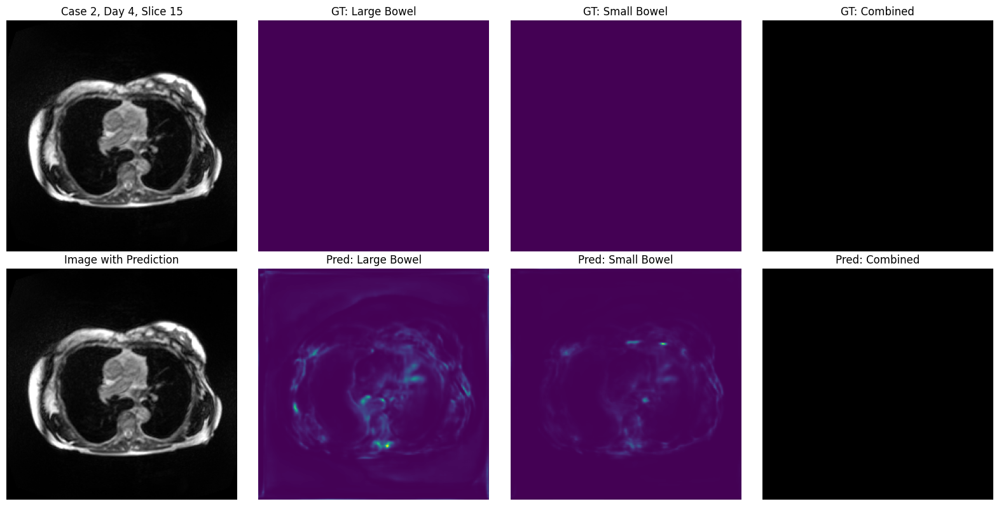

Dice scores - Large Bowel: 0.0000, Small Bowel: 0.0000, Stomach: 0.0000
Average Dice: 0.0000


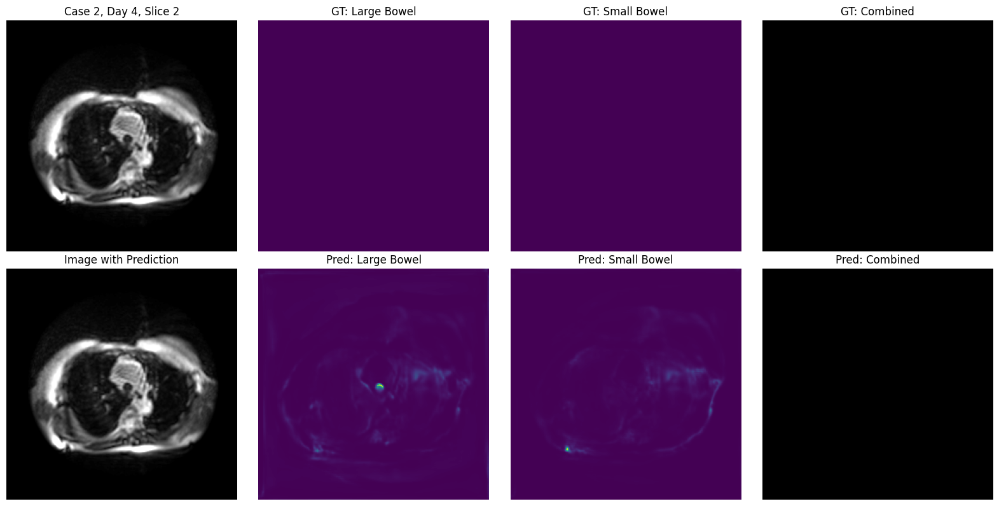

Dice scores - Large Bowel: 0.0000, Small Bowel: 0.0000, Stomach: 0.0000
Average Dice: 0.0000


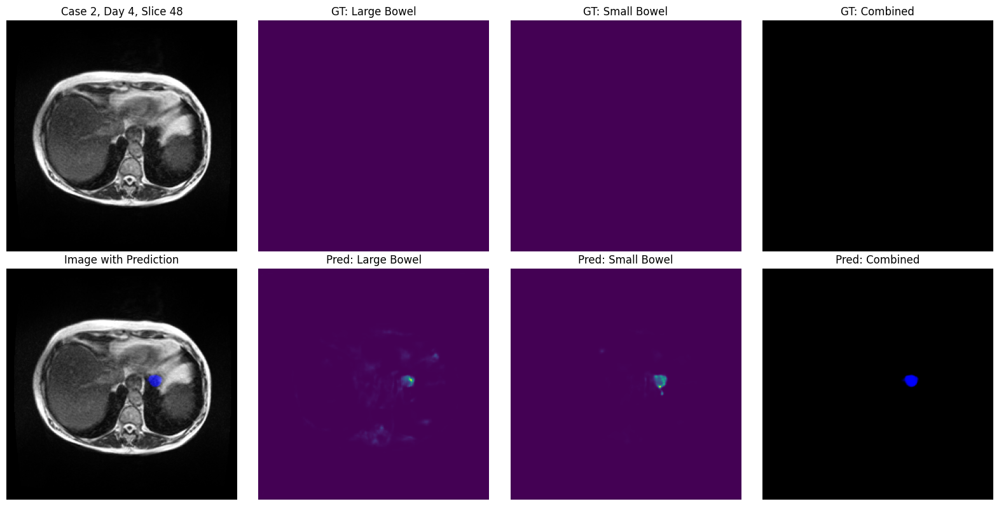

Dice scores - Large Bowel: 0.0000, Small Bowel: 0.0000, Stomach: 0.0000
Average Dice: 0.0000


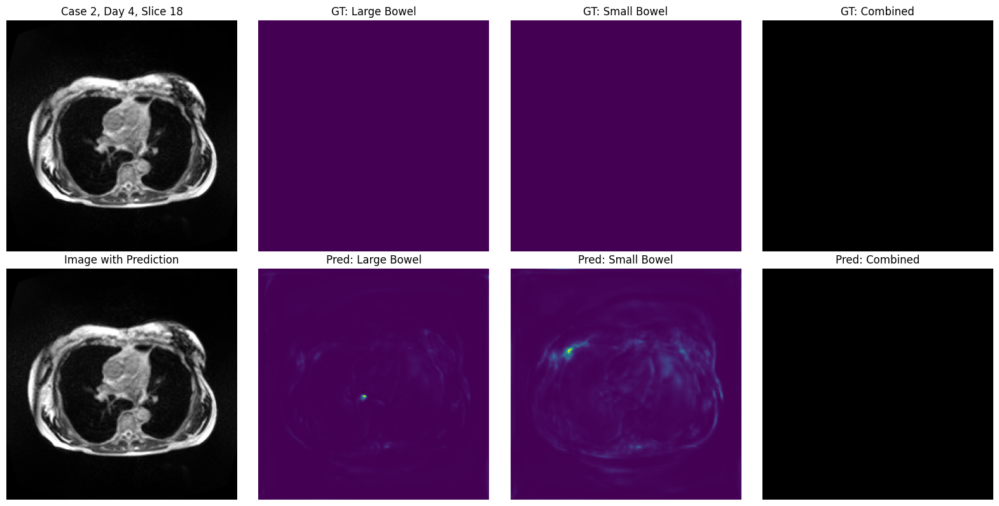

Dice scores - Large Bowel: 0.0000, Small Bowel: 0.0000, Stomach: 0.0000
Average Dice: 0.0000


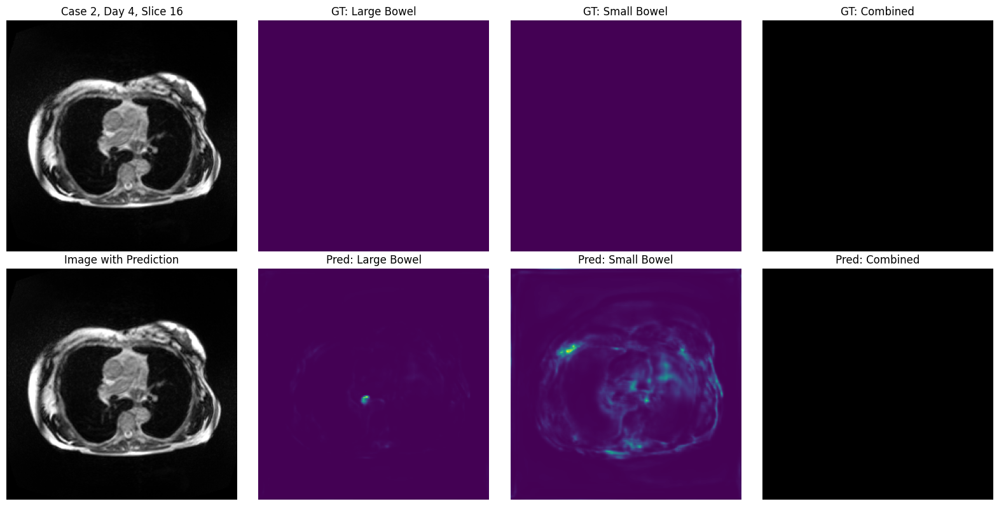

Dice scores - Large Bowel: 0.0000, Small Bowel: 0.0000, Stomach: 0.0000
Average Dice: 0.0000


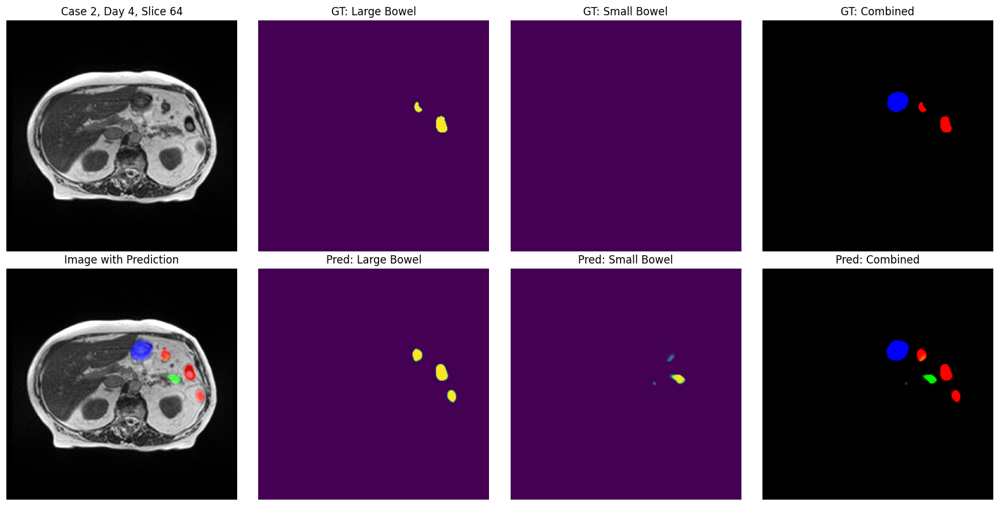

Dice scores - Large Bowel: 0.7275, Small Bowel: 0.0000, Stomach: 0.9519
Average Dice: 0.5598


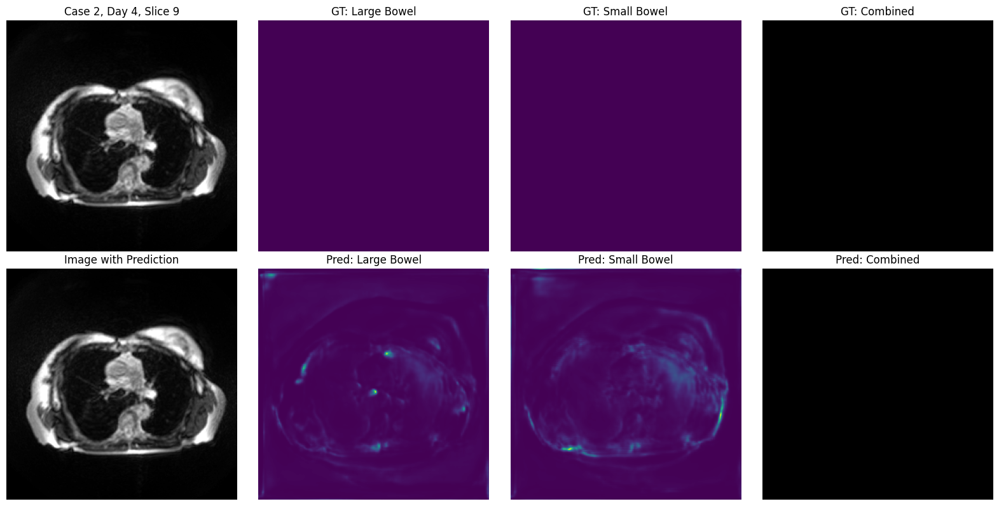

Dice scores - Large Bowel: 0.0000, Small Bowel: 0.0000, Stomach: 0.0000
Average Dice: 0.0000


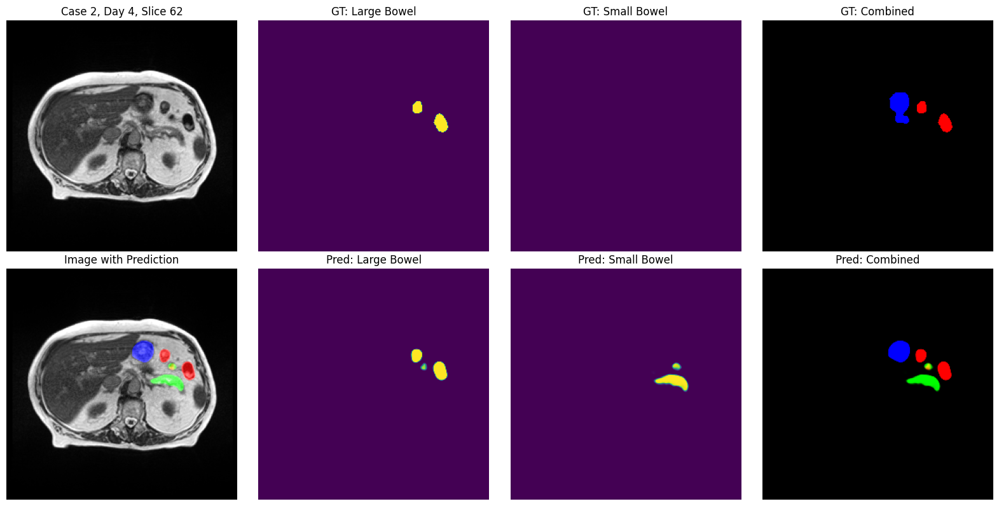

Dice scores - Large Bowel: 0.8718, Small Bowel: 0.0000, Stomach: 0.8202
Average Dice: 0.5640


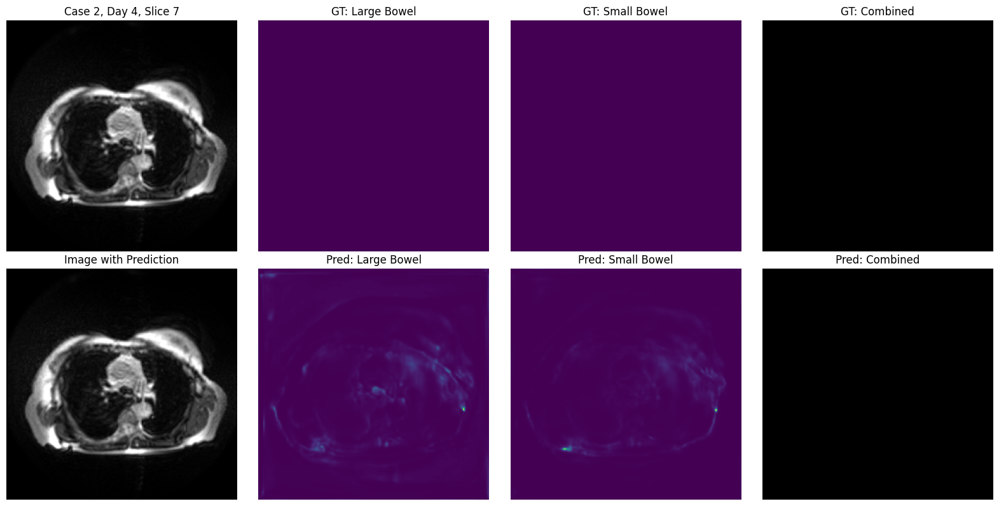

Dice scores - Large Bowel: 0.0000, Small Bowel: 0.0000, Stomach: 0.0000
Average Dice: 0.0000


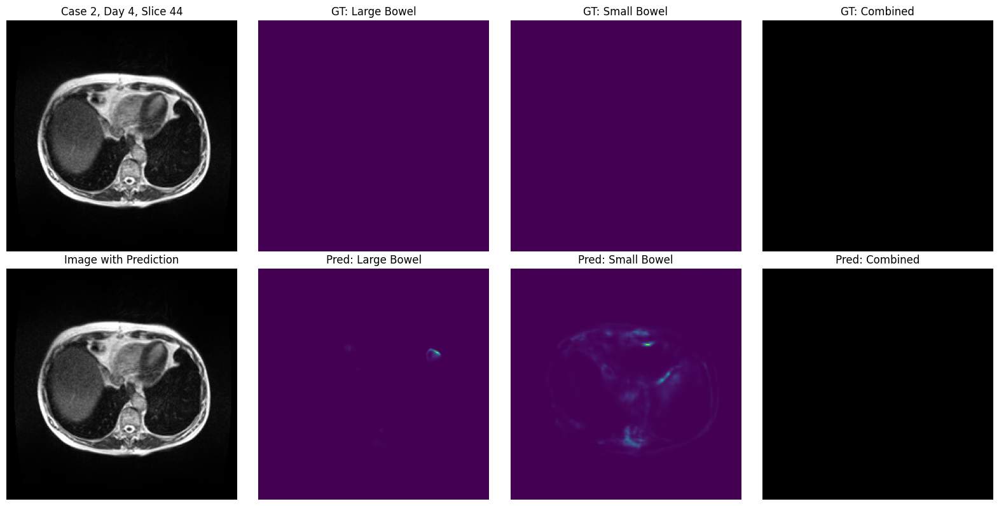

Dice scores - Large Bowel: 0.0000, Small Bowel: 0.0000, Stomach: 0.0000
Average Dice: 0.0000
Visualization completed!


In [59]:
def load_model_and_visualize(model_path='gi_tract_segmentation_model.pth', num_samples=5):
    """
    Load the trained model and visualize predictions
    
    Args:
        model_path: Path to the saved model weights
        num_samples: Number of samples to visualize
    """
    print("Loading model and visualizing predictions...")
    
    # Check if GPU is available
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    
    # Create model architecture
    model = UNetWithResNetBackbone(backbone='resnet34', num_classes=3, pretrained=False)
    
    # Load saved weights
    model.load_state_dict(torch.load(model_path, map_location=device))
    model = model.to(device)
    
    # Make sure val_loader is defined
    if 'val_loader' not in globals() or globals()['val_loader'] is None:
        print("WARNING: val_loader not found. Make sure it's defined.")
        return
    
    # Visualize predictions
    visualize_predictions(model, val_loader, num_samples=num_samples, device=device)
    
    print("Visualization completed!")

# Run the visualization
if __name__ == "__main__":
    # Make sure val_loader is defined before running this
    load_model_and_visualize(num_samples=10)